In [1]:
import pandas as pd
import plotly.express as px
import seaborn as sns
from numpy import median
import matplotlib.pyplot as plt
import matplotlib as mpl
import folium
from folium import Map, Choropleth
import json
from folium import Map, Marker
from folium.plugins import MarkerCluster
import numpy as np

In [2]:
plt.style.use('seaborn-pastel')

#### Шаг 1. Загрузите данные и изучите общую информацию

In [3]:
data = pd.read_csv('/datasets/moscow_places.csv')
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


In [5]:
# проверка на пропуски
data.isna().sum() 

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                3611
dtype: int64

Данных 8406 строки, есть пропуски в данных.<br>
Тип float в столбцах с данными о широте и долготе, рейтинге, среднем чеке и средней цене - это корректно, а также в стоблце с данными о количестве мест - нужен был бы тип int, но в данных есть пропуски.<br>
Тип int у столбца с признаком сети (значения 0 и 1). <br>
У всех остальных столбцов строковый тип.

#### Шаг 2. Выполните предобработку данных

In [6]:
# признак сетевое/не сетевое
data['chain'] = data['chain'].apply(lambda x: 'сетевое' if x == 1 else 'не сетевое')

Столбец с временем работы (hours) содержит строковый тип данных, заполним пропущенные значения строкой, т.к. нет возможности узнать расписание:

In [7]:
# заполнение пропусков во времени работы 
data['hours'] = data['hours'].fillna('неизвестно')

In [8]:
# проверка на дубли
data.duplicated().sum()

0

In [9]:
# проверка на дубли
data.duplicated(subset=['name', 'address']).sum()

0

In [10]:
# название в нижнем шрифте без пробелов в начале и конце
data['name_lower'] = data['name'].str.lower().str.strip()
# проверка на дубли
data.duplicated(subset=['name_lower', 'address']).sum()

3

In [11]:
# удаление дублей
data = data.drop_duplicates(subset=['name_lower', 'address'], keep='first')

In [12]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8403 entries, 0 to 8405
Data columns (total 15 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8403 non-null   object 
 1   category           8403 non-null   object 
 2   address            8403 non-null   object 
 3   district           8403 non-null   object 
 4   hours              8403 non-null   object 
 5   lat                8403 non-null   float64
 6   lng                8403 non-null   float64
 7   rating             8403 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8403 non-null   object 
 13  seats              4792 non-null   float64
 14  name_lower         8403 non-null   object 
dtypes: float64(6), object(9)
memory usage: 1.0+ MB


Найденные дубли удалены.

In [13]:
data[data.duplicated(subset=['address'])]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,name_lower
7,Mr. Уголёк,быстрое питание,"Москва, Клязьминская улица, 9, стр. 3",Северный административный округ,"пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00...",55.890636,37.524303,4.7,средние,Средний счёт:200–300 ₽,250.0,NaN,не сетевое,45.0,mr. уголёк
20,Чебуреки Манты,кафе,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.880287,37.448646,4.3,NaN,NaN,NaN,NaN,сетевое,148.0,чебуреки манты
31,Алталия,быстрое питание,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878691,37.478993,4.1,NaN,NaN,NaN,NaN,не сетевое,NaN,алталия
41,Крошка Картошка,быстрое питание,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878515,37.479308,4.1,NaN,NaN,NaN,NaN,сетевое,NaN,крошка картошка
48,БлинБери,ресторан,"Москва, улица Дыбенко, 7, стр. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.878511,37.479158,3.9,NaN,NaN,NaN,NaN,сетевое,4.0,блинбери
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8401,Суши Мания,кафе,"Москва, Профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.552480,4.4,NaN,NaN,NaN,NaN,не сетевое,86.0,суши мания
8402,Миславнес,кафе,"Москва, Пролетарский проспект, 19, корп. 1",Южный административный округ,"ежедневно, 08:00–22:00",55.640875,37.656553,4.8,NaN,NaN,NaN,NaN,не сетевое,150.0,миславнес
8403,Самовар,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN,не сетевое,150.0,самовар
8404,Чайхана Sabr,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,NaN,NaN,NaN,NaN,сетевое,150.0,чайхана sabr


По одному адресу могут находиться разные заведения.

In [14]:
# категории
data['category'].unique()

array(['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб',
       'быстрое питание', 'булочная', 'столовая'], dtype=object)

In [15]:
# районы
data['district'].unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

In [16]:
# время работы 
data['hours'].unique()

array(['ежедневно, 10:00–22:00',
       'пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00',
       'ежедневно, 09:00–22:00', ...,
       'пн-пт 08:30–21:30; сб,вс 09:00–21:30',
       'пн-чт 13:00–22:00; пт,сб 13:00–22:30; вс 13:00–22:00',
       'пн-сб 10:30–21:30'], dtype=object)

In [17]:
len(data['hours'].unique())

1307

Вариантов расписаний много.

In [18]:
data[data['hours'].str.contains('круглосуточно')]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,name_lower
10,Great Room Bar,"бар,паб","Москва, Левобережная улица, 12",Северный административный округ,"ежедневно, круглосуточно",55.877832,37.469171,4.5,средние,Цена бокала пива:250–350 ₽,NaN,NaN,не сетевое,102.0,great room bar
17,Чайхана Беш-Бармак,ресторан,"Москва, Ленинградское шоссе, 71Б, стр. 2",Северный административный округ,"ежедневно, круглосуточно",55.876908,37.449876,4.4,средние,Средний счёт:350–500 ₽,425.0,NaN,не сетевое,96.0,чайхана беш-бармак
19,Пекарня,булочная,"Москва, Ижорский проезд, 5",Северный административный округ,"ежедневно, круглосуточно",55.887969,37.515688,4.4,NaN,NaN,NaN,NaN,сетевое,NaN,пекарня
24,Drive Café,кафе,"Москва, улица Дыбенко, 9Ас1",Северный административный округ,"ежедневно, круглосуточно",55.879992,37.481571,4.0,NaN,NaN,NaN,NaN,сетевое,NaN,drive café
49,2U-Ту-Ю,пиццерия,"Москва, Ижорская улица, 8А",Северный административный округ,"ежедневно, круглосуточно",55.886160,37.508784,2.7,NaN,Средний счёт:900 ₽,900.0,NaN,не сетевое,NaN,2u-ту-ю
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8394,Намангале,кафе,"Москва, Ферганская улица, вл17-21",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.705332,37.819244,4.3,NaN,NaN,NaN,NaN,не сетевое,NaN,намангале
8399,"Пекарня, кафе-гриль",булочная,"Москва, Болотниковская улица, 52, корп. 2",Юго-Западный административный округ,"ежедневно, круглосуточно",55.662866,37.582572,4.2,NaN,Средний счёт:50–250 ₽,150.0,NaN,не сетевое,50.0,"пекарня, кафе-гриль"
8403,Самовар,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN,не сетевое,150.0,самовар
8404,Чайхана Sabr,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,NaN,NaN,NaN,NaN,сетевое,150.0,чайхана sabr


In [19]:
# признак 24/7
data['is_24_7'] = data['hours'].str.contains('ежедневно, круглосуточно')
data

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,name_lower,is_24_7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,не сетевое,NaN,wowфли,False
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,не сетевое,4.0,четыре комнаты,False
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,не сетевое,45.0,хазри,False
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,не сетевое,NaN,dormouse coffee shop,False
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,сетевое,148.0,иль марко,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8401,Суши Мания,кафе,"Москва, Профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.552480,4.4,NaN,NaN,NaN,NaN,не сетевое,86.0,суши мания,False
8402,Миславнес,кафе,"Москва, Пролетарский проспект, 19, корп. 1",Южный административный округ,"ежедневно, 08:00–22:00",55.640875,37.656553,4.8,NaN,NaN,NaN,NaN,не сетевое,150.0,миславнес,False
8403,Самовар,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN,не сетевое,150.0,самовар,True
8404,Чайхана Sabr,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,NaN,NaN,NaN,NaN,сетевое,150.0,чайхана sabr,True


In [20]:
# данные об улице
data['street'] = data.apply(lambda x: x.address.split(', ')[1], axis=1)
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,name_lower,is_24_7,street
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,не сетевое,NaN,wowфли,False,улица Дыбенко
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,не сетевое,4.0,четыре комнаты,False,улица Дыбенко
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,не сетевое,45.0,хазри,False,Клязьминская улица
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,не сетевое,NaN,dormouse coffee shop,False,улица Маршала Федоренко
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,сетевое,148.0,иль марко,False,Правобережная улица


In [21]:
# данные, в которых отсутствует категория цен, но есть средний чек
data[data['price'].isna() & data['middle_avg_bill'].notna()]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,name_lower,is_24_7,street
27,Шаурму Х@чу,быстрое питание,"Москва, улица Дыбенко, 7, стр. 1",Северный административный округ,"пн-пт 08:00–22:00; сб,вс 10:00–22:00",55.879324,37.480280,4.1,NaN,Средний счёт:от 240 ₽,240.0,NaN,не сетевое,4.0,шаурму х@чу,False,улица Дыбенко
32,Додо Пицца,пиццерия,"Москва, Коровинское шоссе, 23, корп. 1",Северный административный округ,"ежедневно, 09:00–23:00",55.877388,37.523334,4.3,NaN,Средний счёт:328 ₽,328.0,NaN,сетевое,46.0,додо пицца,False,Коровинское шоссе
34,Домино'с Пицца,пиццерия,"Москва, Клязьминская улица, 11, корп. 4",Северный административный округ,"ежедневно, 10:00–23:00",55.886963,37.523518,4.2,NaN,Средний счёт:от 500 ₽,500.0,NaN,сетевое,247.0,домино'с пицца,False,Клязьминская улица
49,2U-Ту-Ю,пиццерия,"Москва, Ижорская улица, 8А",Северный административный округ,"ежедневно, круглосуточно",55.886160,37.508784,2.7,NaN,Средний счёт:900 ₽,900.0,NaN,не сетевое,NaN,2u-ту-ю,True,Ижорская улица
84,Meat Doner Kebab,булочная,"Москва, улица Лескова, 22",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.896987,37.608126,4.5,NaN,Средний счёт:300 ₽,300.0,NaN,не сетевое,0.0,meat doner kebab,True,улица Лескова
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8347,Compass Coffee&Bakery,кафе,"Москва, Окская улица, 1, корп. 1",Юго-Восточный административный округ,"пн-пт 10:00–22:00; сб,вс 11:00–22:00",55.712435,37.752065,4.0,NaN,Средний счёт:300–400 ₽,350.0,NaN,не сетевое,80.0,compass coffee&bakery,False,Окская улица
8366,Ситипицца,пиццерия,"Москва, Ферганская улица, 12",Юго-Восточный административный округ,"ежедневно, 10:00–23:00",55.708143,37.808957,4.2,NaN,Средний счёт:300–700 ₽,500.0,NaN,не сетевое,4.0,ситипицца,False,Ферганская улица
8383,Pizza24/7,пиццерия,"Москва, улица Юных Ленинцев, 10/15к1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.698824,37.738878,4.2,NaN,Средний счёт:150 ₽,150.0,NaN,не сетевое,NaN,pizza24/7,True,улица Юных Ленинцев
8399,"Пекарня, кафе-гриль",булочная,"Москва, Болотниковская улица, 52, корп. 2",Юго-Западный административный округ,"ежедневно, круглосуточно",55.662866,37.582572,4.2,NaN,Средний счёт:50–250 ₽,150.0,NaN,не сетевое,50.0,"пекарня, кафе-гриль",True,Болотниковская улица


In [22]:
# данные, отсутствует категория цен, но есть цена кофе
data[data['price'].isna() & data['middle_coffee_cup'].notna()]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,name_lower,is_24_7,street
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,не сетевое,NaN,dormouse coffee shop,False,улица Маршала Федоренко
81,Coffee Way,кофейня,"Москва, Алтуфьевское шоссе, 86, корп. 1",Северо-Восточный административный округ,"ежедневно, 09:00–22:00",55.897789,37.588189,4.3,NaN,Цена чашки капучино:120–170 ₽,NaN,145.0,сетевое,120.0,coffee way,False,Алтуфьевское шоссе
106,Вектор,кофейня,"Москва, Алтуфьевское шоссе, 48, корп. 1",Северо-Восточный административный округ,пн-пт 07:30–18:30,55.876142,37.588024,4.4,NaN,Цена чашки капучино:80–160 ₽,NaN,120.0,не сетевое,120.0,вектор,False,Алтуфьевское шоссе
151,Шоколадница,кофейня,"Москва, Дмитровское шоссе, 163Ак1",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.910447,37.542227,4.1,NaN,Цена чашки капучино:239–274 ₽,NaN,256.0,сетевое,NaN,шоколадница,False,Дмитровское шоссе
238,Причина для Капучино,кофейня,"Москва, Полярная улица, 27, корп. 4",Северо-Восточный административный округ,"ежедневно, 08:00–21:00",55.883391,37.636985,4.4,NaN,Цена чашки капучино:130–190 ₽,NaN,160.0,не сетевое,NaN,причина для капучино,False,Полярная улица
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8301,Кофейня 1981,кофейня,"Москва, 2-й Грайвороновский проезд, 44, корп. 1",Юго-Восточный административный округ,"ежедневно, 08:00–22:00",55.725467,37.745483,4.5,NaN,Цена чашки капучино:160–230 ₽,NaN,195.0,не сетевое,NaN,кофейня 1981,False,2-й Грайвороновский проезд
8308,Бариста Стайл,кофейня,"Москва, Новохохловская улица, 49",Юго-Восточный административный округ,пн-пт 07:00–18:00,55.724337,37.716230,4.9,NaN,Цена чашки капучино:130–170 ₽,NaN,150.0,не сетевое,NaN,бариста стайл,False,Новохохловская улица
8342,Coffee Week,кофейня,"Москва, Рязанский проспект, 30, корп. 2",Юго-Восточный административный округ,"пн-пт 08:30–21:30; сб,вс 09:00–21:30",55.718199,37.784447,4.3,NaN,Цена чашки капучино:120–220 ₽,NaN,170.0,не сетевое,116.0,coffee week,False,Рязанский проспект
8365,Квадрат кофе,кофейня,"Москва, Волгоградский проспект, 73, стр. 1",Юго-Восточный административный округ,"пн-пт 08:30–21:30; сб,вс 09:00–21:30",55.709710,37.744450,4.2,NaN,Цена чашки капучино:100–220 ₽,NaN,160.0,не сетевое,206.0,квадрат кофе,False,Волгоградский проспект


Категорию цены (средняя/высокая и др.) для кофеен можно определить по цене за кофе, а для других видов заведений по среднему чеку. Категорию цены возьмем самую часто встречающуюся по среднему чеку/цене кофе в своей категории:

In [23]:
# получение категории цен по среднему чеку и категории
def get_price(row, use_filter=True):    
    if row['category'] == 'кофейня' and use_filter:
        data_price = (data.loc[(data['category'] == row['category']) & (data['middle_coffee_cup_round'] == row['middle_coffee_cup_round']), 'price']
                      .value_counts()
                      .reset_index()) 
        if data_price.shape[0] > 0:
            return data_price.loc[0, 'index']
    else:
        data_price = (data.loc[(data['category'] == row['category']) & (data['middle_avg_bill_round'] == row['middle_avg_bill_round']), 'price']
                      .value_counts()
                      .reset_index()) 
        if data_price.shape[0] > 0:
            return data_price.loc[0, 'index']       

In [24]:
# округленный средний чек
data['middle_avg_bill_round'] = data['middle_avg_bill'].round(decimals=-2)
# округленная средняя цена за кофе
data['middle_coffee_cup_round'] = data['middle_coffee_cup'].round(decimals=-1)

In [25]:
# заполнение категории цен по окр. средней цене кофе
data_middle_avg = data.loc[(data['category'] == 'кофейня'),['category', 'middle_coffee_cup_round']].drop_duplicates().dropna()
for index, row in data_middle_avg.iterrows():
    data.loc[(data['category'] == row['category']) & (data['middle_coffee_cup_round'] == row['middle_coffee_cup_round']) & (data['price'].isna()), 'price'] = get_price(row)

# заполнение категории цен по окр. среднему чеку
data_middle_avg = data[['category', 'middle_avg_bill_round']].drop_duplicates().dropna()
for index, row in data_middle_avg.iterrows():
    data.loc[(data['category'] == row['category']) & (data['middle_avg_bill_round'] == row['middle_avg_bill_round']) & (data['price'].isna()), 'price'] = get_price(row, False)


In [26]:
# пропуски
data['price'].isna().sum()

4372

Примерно половина данных без категории цены, но больше ничем заполнить не получится.<br>
Пропуски в данных с информацией о среднем чеке/средней цене за кофе и количестве мест корректно никак не получится заполнить.

#### Шаг 3. Анализ данных

In [27]:
# категории заведений
data['category'].value_counts()

кафе               2377
ресторан           2042
кофейня            1413
бар,паб             764
пиццерия            633
быстрое питание     603
столовая            315
булочная            256
Name: category, dtype: int64

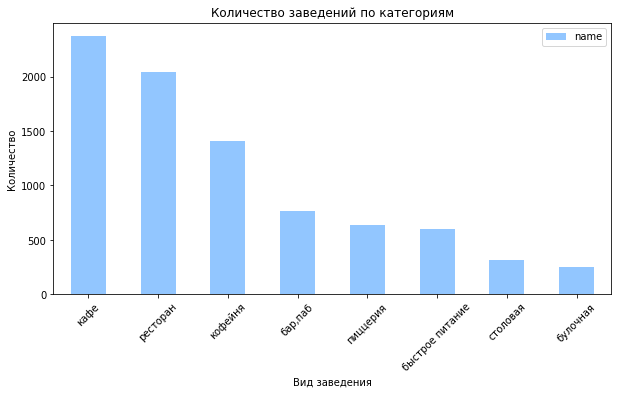

In [28]:
# количество заведений по категориям
data_pivot = data.pivot_table(index='category', values='name', aggfunc='count').sort_values(by=['name'], ascending=False)
data_pivot.plot(y='name', kind='bar', figsize=(10, 5));
plt.title('Количество заведений по категориям')
plt.xlabel('Вид заведения')
plt.ylabel('Количество')
plt.xticks(rotation=45)
plt.show()

Больше всего кафе, ресторанов и кофеен. <br>

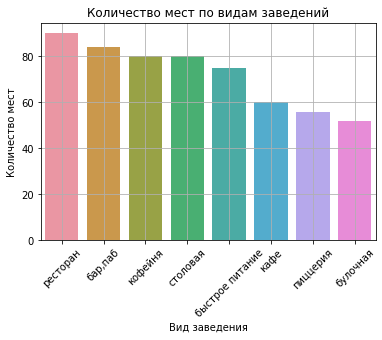

In [29]:
# количество мест по видам заведений
data_pivot = data[data['seats'] != 0].pivot_table(index='category', values='seats', aggfunc='median').reset_index().sort_values(by=['seats'], ascending=False)
ax = sns.barplot(x='category', y='seats', data=data_pivot) 
plt.title('Количество мест по видам заведений')
plt.xlabel('Вид заведения')
plt.ylabel('Количество мест')
plt.xticks(rotation=45)
plt.grid()
plt.show()

Больше всего посадочных мест в ресторанах (более 80), а также в барах, кофейнях, столовых и быстром питании. 60 и менее мест у кафе, пиццерий и булочных.

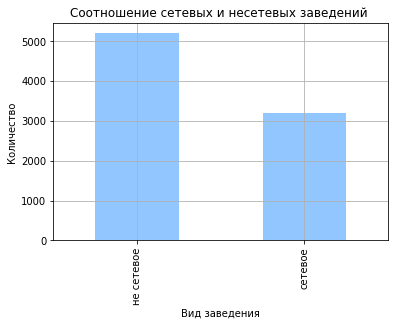

In [30]:
# сетевые и несетевые заведения
data_pivot = data.pivot_table(index='chain', values='name', aggfunc='count').sort_values(by=['name'], ascending=False)
ax =  data_pivot.plot(y='name', kind='bar');
plt.title('Соотношение сетевых и несетевых заведений ')
plt.xlabel('Вид заведения')
plt.ylabel('Количество')
ax.get_legend().remove()
plt.grid()
plt.show()

Не сетевых заведений больше.

Круговая диаграмма долей: <br>

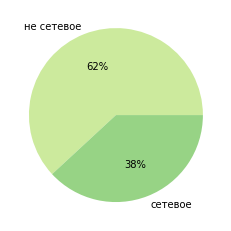

In [31]:
data_groupped = data.groupby(['chain'], as_index = False)[['name']].count()
plt.pie(data_groupped['name'], labels = data_groupped['chain'], colors = sns.color_palette('YlGn')[1:3], autopct='%.0f%%')
plt.show()

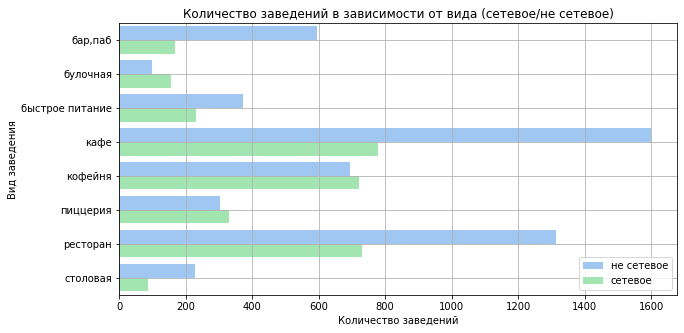

In [32]:
# категории заведений, которые чаще являются сетевыми
data_groupped = data.groupby(['category', 'chain'], \
                        as_index = False)[['name']].count()
# назначаем размер графика
plt.figure(figsize=(10, 5))
# строим столбчатый график средствами seaborn
sns.barplot(x='name', y='category', data=data_groupped, hue='chain')
plt.title('Количество заведений в зависимости от вида (сетевое/не сетевое)')
plt.xlabel('Количество заведений')
plt.ylabel('Вид заведения')
plt.legend(loc='lower right', fontsize=10)
plt.grid()
plt.show()

Для разных категорий заведений пропорция сетевых и не сетевых отличается: 
- в основном заведения не сетевые
- у кофеен и пиццерий пропорции сетевых и не сетевых примерно равны
- у булочных больше сетевых заведений, чем не сетевых

Круговая диаграмма c долями: <br>

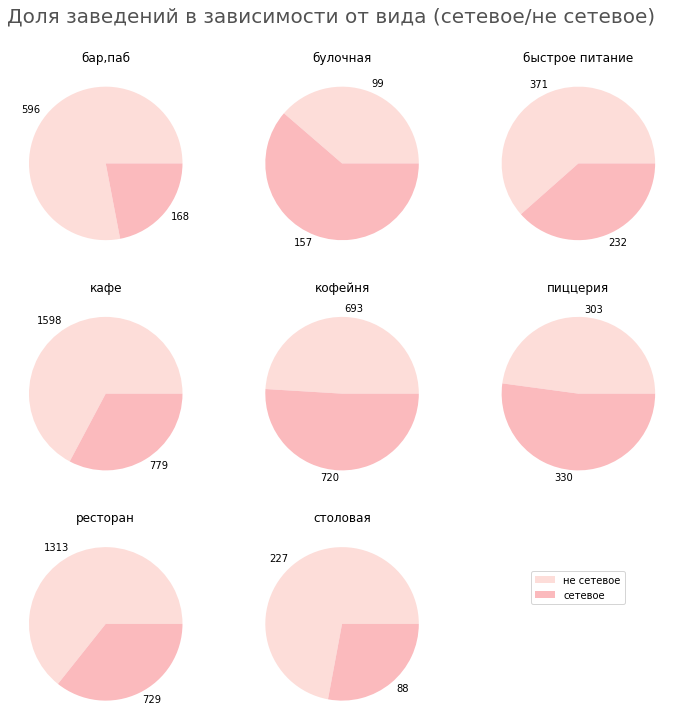

In [33]:
table = pd.pivot_table(data_groupped, index=['category'], columns=['chain'])

font_color = '#525252'
fig, axes = plt.subplots(3, 3, figsize=(12,12))
fig.delaxes(ax= axes[2, 2])  
title = fig.suptitle('Доля заведений в зависимости от вида (сетевое/не сетевое)', y=.95, fontsize=20, color=font_color) 
for i, (idx, row) in enumerate(table.iterrows()):
    ax = axes[i // 3, i % 3]
    ax.pie(table.loc[idx], labels=table.loc[idx],colors=sns.color_palette('RdPu')[0:2])
    ax.set(ylabel='', title=idx, aspect='equal')
    
ax.legend(table.columns.levels[1], bbox_to_anchor=(2, 0.8))
plt.show()

In [34]:
#Код ревьюера
df_chain_share = data.pivot_table(index='category', columns='chain', values='name', aggfunc='count')
df_chain_share.columns = ['not_chain', 'chain']
df_chain_share['total'] = df_chain_share['not_chain'] + df_chain_share['chain']
df_chain_share['share'] = (df_chain_share['chain']/df_chain_share['total']*100).round().astype('int')
df_chain_share.sort_values(by='share', ascending=False)

,not_chain,chain,total,share
category,,,,
булочная,99,157,256,61
пиццерия,303,330,633,52
кофейня,693,720,1413,51
быстрое питание,371,232,603,38
ресторан,1313,729,2042,36
кафе,1598,779,2377,33
столовая,227,88,315,28
"бар,паб",596,168,764,22


Доли сетевых заведений: <br>

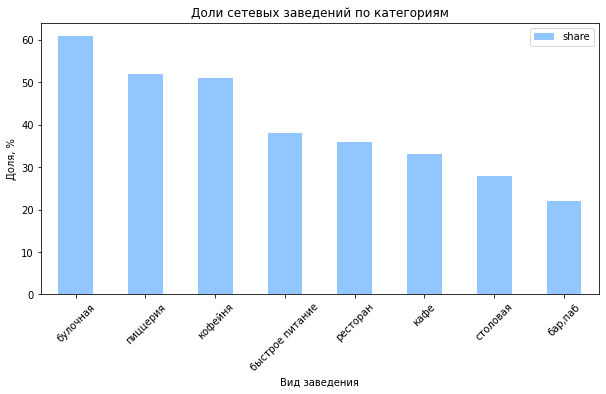

In [35]:
# доли сетевых заведений
df_chain_share = df_chain_share.sort_values(by='share', ascending=False)
df_chain_share.plot(y='share', kind='bar', figsize=(10, 5));
plt.title('Доли сетевых заведений по категориям')
plt.xlabel('Вид заведения')
plt.ylabel('Доля, %')
plt.xticks(rotation=45)
plt.show()

Самый высокий процент сетевых заведений у булочных - 61%, у  пиццерий и кофеен около 50%, самый низкий процент у баров - 22%.<br>

In [102]:
# топ-15 популярных сетей в Москве
data_groupped = (data[data['chain'] == 'сетевое']
                 .groupby(['category', 'name'], as_index = False)
                 .agg({'address':'count', 'rating':'median', 'middle_avg_bill':'median', 'middle_coffee_cup':'median',  'seats':'median'}) #[['address']].count()
                 .sort_values(by=['address'], ascending=False))
data_groupped.head(15)

,category,name,address,rating,middle_avg_bill,middle_coffee_cup,seats
766,кофейня,Шоколадница,119,4.2,650.0,256.0,96.0
800,пиццерия,Домино'с Пицца,76,4.2,500.0,NaN,40.0
799,пиццерия,Додо Пицца,74,4.3,391.5,NaN,52.0
668,кофейня,One Price Coffee,71,4.2,NaN,80.0,99.5
1105,ресторан,Яндекс Лавка,69,4.0,NaN,NaN,46.0
641,кофейня,Cofix,65,4.1,NaN,60.0,87.5
888,ресторан,Prime,49,4.2,300.0,NaN,97.0
711,кофейня,КОФЕПОРТ,42,4.2,NaN,95.0,85.0
431,кафе,Кулинарная лавка братьев Караваевых,39,4.4,450.0,NaN,70.0
1062,ресторан,Теремок,36,4.1,325.0,NaN,87.5


Кажется, данные о категориях не совсем точные: Шоколадница - это больше кафе, чем кофейня, Яндекс Лавка - служба доставки, а не ресторан, Теремок - быстрое питание. Неясно, как в таком случае ориентироваться по категориям заведений.<br>
У этих заведений медианный рейтинг не ниже 4, но и не самый высокий - выше 4.5 нет. У всех заведений невысокие цены (судя по чеку/ цене за кофе), кроме Кофемании. <br>
Из всего этого можно сделать вывод, что эти заведения популярны больше из-за доступных цен, а не безупречного сервиса и т.п.

Визуализация: <br>

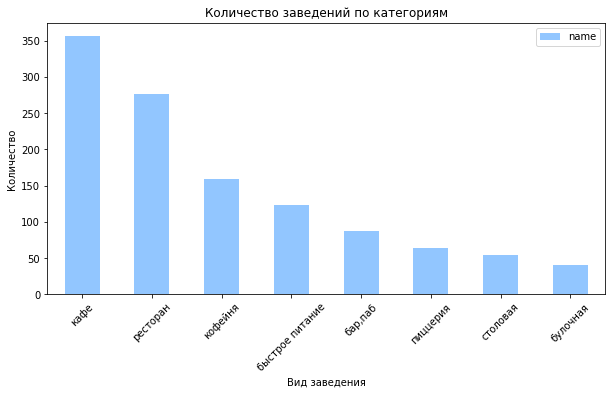

In [37]:
# количество заведений по категориям
data_pivot = data_groupped.pivot_table(index='category', values='name', aggfunc='count').sort_values(by=['name'], ascending=False)
data_pivot.plot(y='name', kind='bar', figsize=(10, 5));
plt.title('Количество заведений по категориям')
plt.xlabel('Вид заведения')
plt.ylabel('Количество')
plt.xticks(rotation=45)
plt.show()

Топ-15 заведений примерно в таких же пропорциях разделился по категориям, как и весь список заведений - больше всего кафе, ресторанов и кофеен, но отличие в том, что быстрое питание здесь вышло вперед баров и пиццерий. Значит, заведения быстрого питания чаще встречаются в крупных сетях.

Визуализация топ-15 сетей: <br>

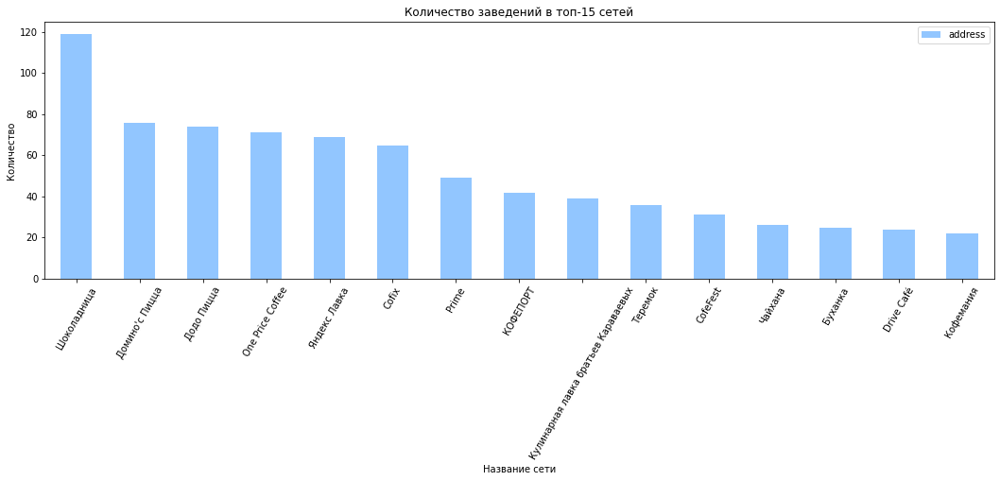

In [38]:
# количество заведений в топ-15 сетей
data_groupped.head(15).plot(x='name', y='address', kind='bar', figsize=(18, 5));
plt.title('Количество заведений в топ-15 сетей')
plt.xlabel('Название сети')
plt.ylabel('Количество')
plt.xticks(rotation=60)
plt.show()

У Шоколадницы значительно больше заведений, чем у других сетей. <br>

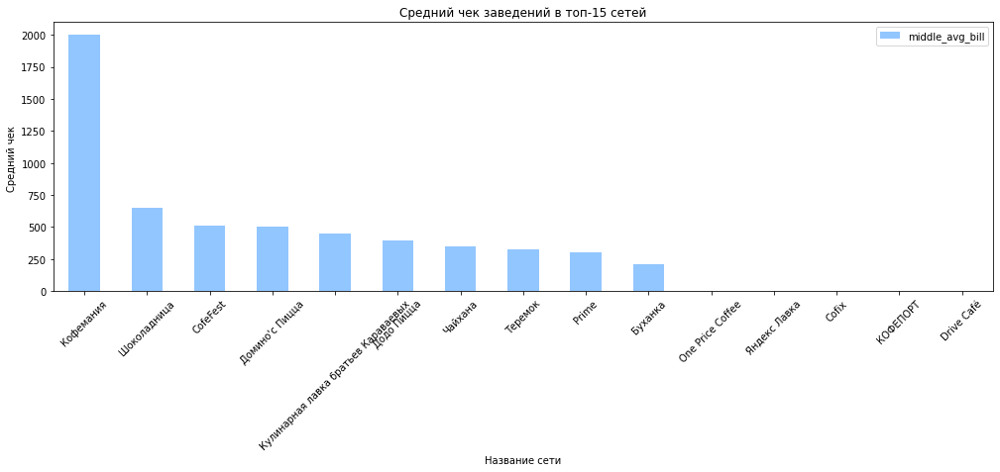

In [39]:
# средний чек заведений
data_groupped.head(15).sort_values(by=['middle_avg_bill'], ascending=False).plot(x='name', y='middle_avg_bill', kind='bar', figsize=(17, 5));
plt.title('Средний чек заведений в топ-15 сетей')
plt.xlabel('Название сети')
plt.ylabel('Средний чек ')
plt.xticks(rotation=45)
plt.show()

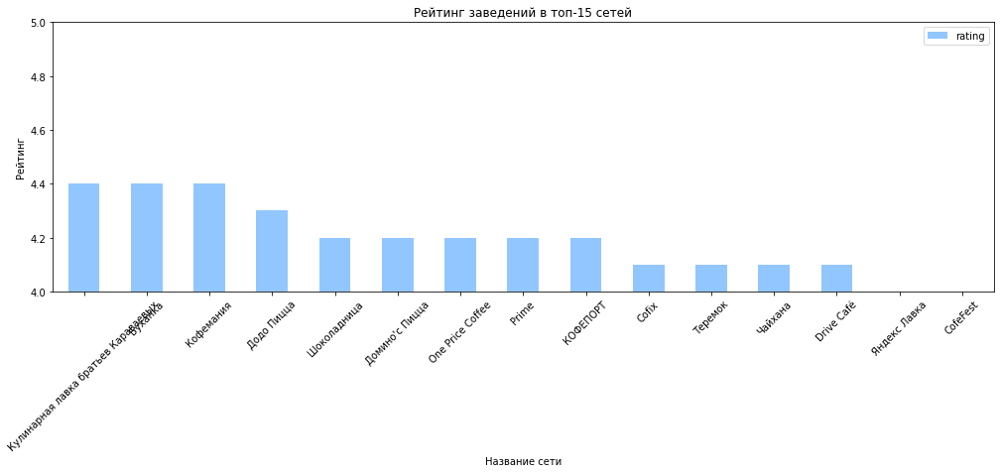

In [103]:
# средний рейтинг заведений
data_groupped.head(15).sort_values(by=['rating'], ascending=False).plot(x='name', y='rating', kind='bar', figsize=(17, 5));
plt.title('Рейтинг заведений в топ-15 сетей')
plt.xlabel('Название сети')
plt.ylabel('Рейтинг')
plt.xticks(rotation=45)
plt.ylim(4, 5)
plt.show()

У Шоколадницы значительно больше заведений, чем у других сетей. <br>

In [41]:
# районы
data['district'].unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

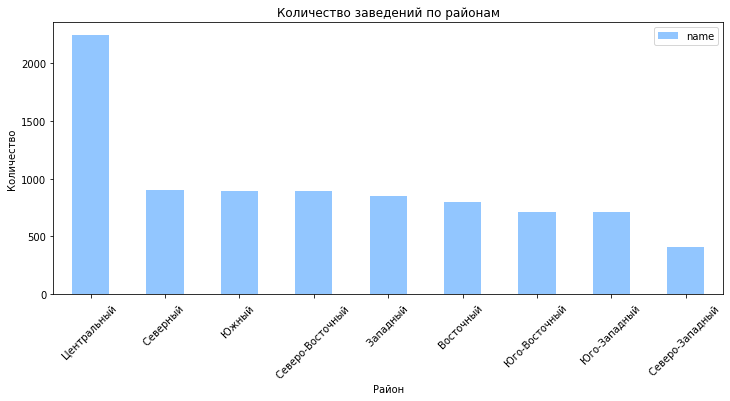

In [42]:
# общее количество заведений по районам
data_pivot = data.pivot_table(index='district', values='name', aggfunc='count').sort_values(by=['name'], ascending=False)
data_pivot.index = data_pivot.index.str.replace('административный округ', '')
data_pivot.plot(y='name', kind='bar', figsize=(12, 5));
plt.title('Количество заведений по районам')
plt.xlabel('Район')
plt.ylabel('Количество')
plt.xticks(rotation=45)
plt.show()

В центральном районе заведений значительно больше, чем в других.

In [43]:
# данные для графика количества заведений каждой категории по районам
df_grouped = data.groupby(['district', 'category']).size().reset_index()
df_grouped['district'] = df_grouped['district'].str.replace('административный округ', '')

table = pd.pivot_table(df_grouped, index=['district'], columns=['category'])
table

0                                                 \
category          бар,паб булочная быстрое питание кафе кофейня пиццерия   
district                                                                   
Восточный              53       25              71  272     105       72   
Западный               50       37              62  238     150       71   
Северный               68       39              58  235     193       77   
Северо-Восточный       62       28              82  269     159       68   
Северо-Западный        23       12              30  115      62       40   
Центральный           364       50              87  464     428      113   
Юго-Восточный          38       13              67  282      89       55   
Юго-Западный           38       27              61  238      96       64   
Южный                  68       25              85  264     131       73   

                                     
category          ресторан столовая  
district                             
Восточный              160       40  
Западный               218       24  
Северный               188       41  
Северо-Восточный       182       40  
Северо-Западный        109       18  
Центральный            670       66  
Юго-Восточный          145       25  
Юго-Западный           168       17  
Южный                  202       44

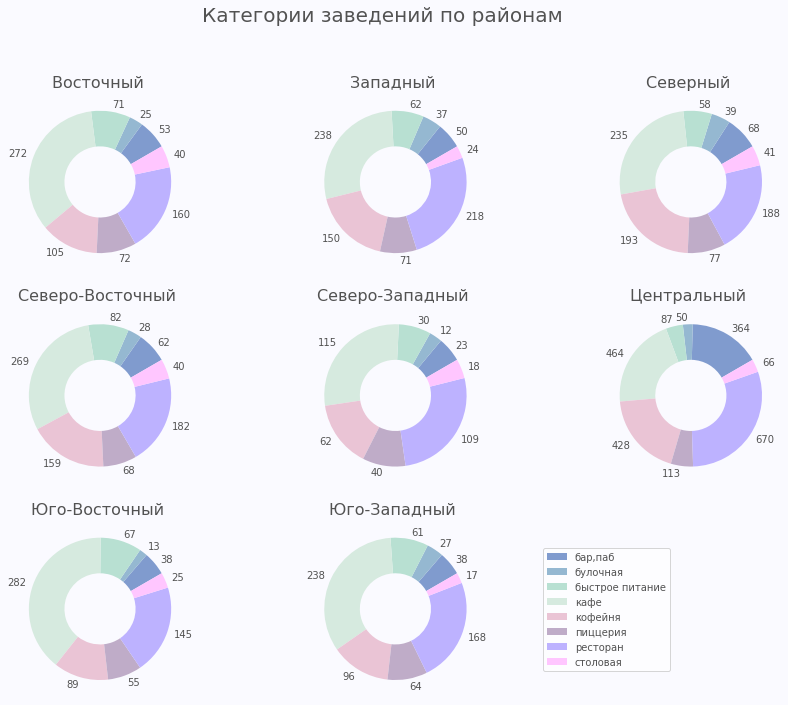

In [44]:
# график количества заведений каждой категорий по районам
font_color = '#525252'
#colors = ['#f7ecb0', '#ffb3e6', '#99ff99', '#66b3ff', '#c7b3fb','#ff6666', '#f9c3b7']
#colors = ['#FFADAD', '#FFD6A5', '#FDFFB6', '#CAFFBF', '#9BF6FF','#A0C4FF', '#BDB2FF', '#FFC6FF']
#colors = ['#bcd4de', '#a5ccd1', '#a0b9bf', '#949ba0', '#4a4063','#bfacc8']
colors = ['#809bce', '#95b8d1', '#b8e0d2', '#d6eadf', '#eac4d5','#bfacc8', '#BDB2FF', '#FFC6FF']
#e8f4f0
fig, axes = plt.subplots(3, 3, figsize=(15, 12), facecolor='#fafaff')
fig.delaxes(ax= axes[2,2])
        
for i, (idx, row) in enumerate(table.head(8).iterrows()):
    ax = axes[i // 3, i % 3]
    row = row[row.gt(row.sum() * .01)]
    ax.pie(row, 
           labels=row.values, 
           startangle=30, 
           wedgeprops=dict(width=.5), 
           colors=colors, 
           textprops={'color':font_color})
    ax.set_title(idx, fontsize=16, color=font_color)
    
    legend = plt.legend([x[1] for x in row.index], 
                        bbox_to_anchor=(1.3, .87), 
                        loc='upper left',  
                        ncol=1, 
                        fancybox=True)
    for text in legend.get_texts():
        plt.setp(text, color=font_color) 

fig.subplots_adjust(wspace=.2) 

title = fig.suptitle('Категории заведений по районам', y=.95, fontsize=20, color=font_color)
plt.subplots_adjust(top=0.85, bottom=0.15)        

В центральном районе больше баров.

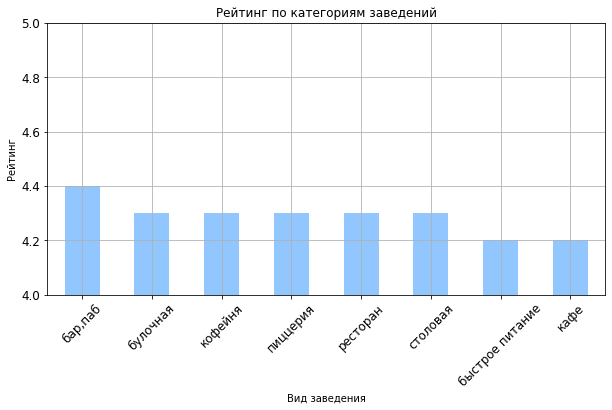

In [45]:
# рейтинги по категориям заведений
data_pivot = data.pivot_table(index='category', values='rating', aggfunc='median').sort_values(by=['rating'], ascending=False)
ax =  data_pivot.plot(y='rating', kind='bar', fontsize=12, figsize=(10, 5));
plt.title('Рейтинг по категориям заведений')
plt.xlabel('Вид заведения')
plt.ylabel('Рейтинг')
plt.xticks(rotation=45)
ax.get_legend().remove()
plt.ylim(4, 5)
plt.grid()
plt.show()

Между медианными рейтингами нет большой разницы по категориям заведений. Самые высокие рейтинги у баров - 4.4. Ниже всего у быстрого питания и кафе - 4.2. У остальных категорий - 4.3.

Визуализация среднего рейтинга: <br>

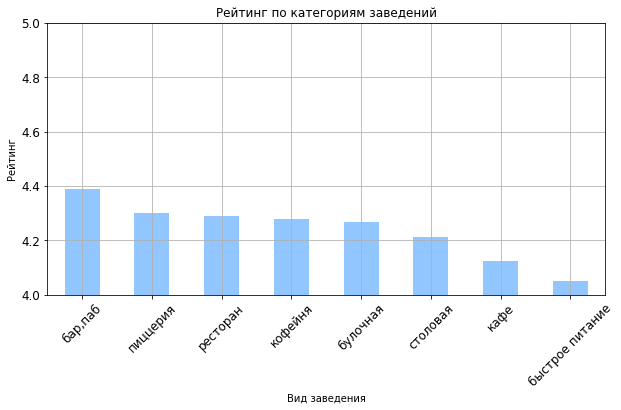

In [46]:
# рейтинги по категориям заведений
data_pivot = data.pivot_table(index='category', values='rating', aggfunc='mean').sort_values(by=['rating'], ascending=False)
ax =  data_pivot.plot(y='rating', kind='bar', fontsize=12, figsize=(10, 5));
plt.title('Рейтинг по категориям заведений')
plt.xlabel('Вид заведения')
plt.ylabel('Рейтинг')
plt.xticks(rotation=45)
ax.get_legend().remove()
plt.ylim(4, 5)
plt.grid()
plt.show()

In [47]:
data_pivot

,rating
category,
"бар,паб",4.387696
пиццерия,4.301264
ресторан,4.290402
кофейня,4.277282
булочная,4.268359
столовая,4.211429
кафе,4.123896
быстрое питание,4.050249


In [48]:
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        tooltip=f"{row['category']}",
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)    
    
def create_marker(row):
    Marker([row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}"
    ).add_to(m)

def create_marker_with_color(row):
    row_color = "red"
    if row['rating'] >= 4.5:
        row_color = "green" 
    elif row['rating'] < 4.5 and row['rating'] >= 4:
        row_color = "orange"  

    Marker([row['lat'], row['lng']],
        icon=folium.Icon(icon='33', prefix='fa', color=row_color),
        popup=f"{row['name']} {row['rating']}"
    ).add_to(m)
    


In [49]:
# фоновая картограмма (хороплет) со средним рейтингом заведений каждого района и со всеми заведениями  
moscow_lat, moscow_lng = 55.751244, 37.618423
m = folium.Map(location=[moscow_lat, moscow_lng], tiles='Cartodb Positron')

data_grouped = data.groupby(['district'])['rating'].agg('median')

Choropleth(
    geo_data='/datasets/admin_level_geomap.geojson',
    data=data_grouped,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)

marker_cluster = MarkerCluster().add_to(m)

data.apply(create_clusters, axis=1)

m

Самый высокий медианный рейтинг в центральном районе.

In [50]:
# фоновая картограмма (хороплет) со средним рейтингом заведений каждого района и со всеми заведениями  
moscow_lat, moscow_lng = 55.751244, 37.618423
m = folium.Map(location=[moscow_lat, moscow_lng], tiles='Cartodb Positron')

data_grouped = data.groupby(['district'])['rating'].agg('mean')

Choropleth(
    geo_data='/datasets/admin_level_geomap.geojson',
    data=data_grouped,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)

marker_cluster = MarkerCluster().add_to(m)

data.apply(create_clusters, axis=1)

m

Визуализация среднего рейтинга: <br>

In [51]:
# количество заведений по улицам
data_groupped_street = data.groupby('street', as_index = False)[['name']].count()
data_groupped_street = data_groupped_street.rename(columns={'name': 'count'})

In [52]:
# топ-15 улиц по количеству заведений
data_groupped = data_groupped_street.sort_values(by=['count'], ascending=False)
data_groupped.head(15)

,street,count
1090,проспект Мира,183
773,Профсоюзная улица,122
1087,проспект Вернадского,108
525,Ленинский проспект,107
523,Ленинградский проспект,95
373,Дмитровское шоссе,88
455,Каширское шоссе,77
298,Варшавское шоссе,76
524,Ленинградское шоссе,70
550,МКАД,65


На проспектах и шоссе много заведений, т.к. это протяженные улицы. МКАД также попал в топ-15.

In [53]:
data_groupped_top15 = data_groupped.reset_index()[:15].merge(data, on=['street'], how='left')
data_groupped_top15

,index,street,count,name,category,address,district,hours,lat,lng,...,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,name_lower,is_24_7,middle_avg_bill_round,middle_coffee_cup_round
0,1090,проспект Мира,183,Все Лень,ресторан,"Москва, проспект Мира, 119, стр. 528",Северо-Восточный административный округ,"пн-чт 12:00–21:00; пт,сб 12:00–22:00; вс 12:00...",55.836107,37.614875,...,выше среднего,Средний счёт:от 1500 ₽,1500.0,NaN,не сетевое,NaN,все лень,False,1500.0,NaN
1,1090,проспект Мира,183,Старое место,кафе,"Москва, проспект Мира, 119, стр. 504",Северо-Восточный административный округ,"ежедневно, 11:00–22:00",55.837212,37.616469,...,средние,Средний счёт:900–1100 ₽,1000.0,NaN,не сетевое,NaN,старое место,False,1000.0,NaN
2,1090,проспект Мира,183,Doner One,кафе,"Москва, проспект Мира, 119, стр. 596",Северо-Восточный административный округ,"ежедневно, 11:00–21:00",55.839037,37.613027,...,NaN,NaN,NaN,NaN,не сетевое,NaN,doner one,False,NaN,NaN
3,1090,проспект Мира,183,Пян-се,быстрое питание,"Москва, проспект Мира, 119, стр. 27",Северо-Восточный административный округ,"ежедневно, 10:00–20:00",55.834563,37.613549,...,NaN,NaN,NaN,NaN,сетевое,NaN,пян-се,False,NaN,NaN
4,1090,проспект Мира,183,Космос,кафе,"Москва, проспект Мира, 119, стр. 34",Северо-Восточный административный округ,вт-вс 10:45–21:00,55.835060,37.622033,...,NaN,NaN,NaN,NaN,не сетевое,NaN,космос,False,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1252,781,Пятницкая улица,48,Правда кофе,кофейня,"Москва, Пятницкая улица, 29",Центральный административный округ,"пн-пт 07:30–22:00; сб,вс 09:00–22:00",55.740840,37.629004,...,низкие,Средний счёт:90–190 ₽,140.0,NaN,сетевое,306.0,правда кофе,False,100.0,NaN
1253,781,Пятницкая улица,48,Cofix,кофейня,"Москва, Пятницкая улица, 8",Центральный административный округ,"ежедневно, 07:00–22:00",55.744056,37.627623,...,NaN,NaN,NaN,NaN,сетевое,10.0,cofix,False,NaN,NaN
1254,781,Пятницкая улица,48,Штолле,булочная,"Москва, Пятницкая улица, 3/4с1",Центральный административный округ,"пн-пт 07:30–19:30; сб,вс 09:00–20:00",55.745460,37.626976,...,NaN,NaN,NaN,NaN,сетевое,NaN,штолле,False,NaN,NaN
1255,781,Пятницкая улица,48,Cofix,кофейня,"Москва, Пятницкая улица, 31, стр. 5",Центральный административный округ,"пн-пт 07:00–22:00; сб,вс 10:00–22:00",55.740685,37.629145,...,NaN,NaN,NaN,NaN,сетевое,130.0,cofix,False,NaN,NaN


In [54]:
# данные для графика количества заведений каждой категории по топ-15 улицам
df_grouped = data_groupped_top15.groupby(['street', 'category']).size().reset_index()

table = pd.pivot_table(df_grouped, index=['street'], columns=['category'])
table = table.fillna(0).astype(int)
table

0                                                 \
category               бар,паб булочная быстрое питание кафе кофейня пиццерия   
street                                                                          
Варшавское шоссе             6        0               7   18      14        4   
Дмитровское шоссе            6        2              10   23      11        8   
Каширское шоссе              2        0              10   20      16        5   
Кутузовский проспект         2        1               2   14      13        3   
Ленинградский проспект      15        4               2   12      25        9   
Ленинградское шоссе          5        2               5   13      13        3   
Ленинский проспект          10        3               2   26      23        5   
Люблинская улица             5        0               5   26      11        1   
МКАД                         1        0               9   45       4        0   
Профсоюзная улица            6        4              15   35      18       15   
Пятницкая улица              9        3               2    7       6        3   
проспект Вернадского         7        1              12   25      16       12   
проспект Мира               11        4              21   53      36       11   
улица Вавилова               2        2              11   15      10        3   
улица Миклухо-Маклая         3        0               4   21       4        2   

                                          
category               ресторан столовая  
street                                    
Варшавское шоссе             20        7  
Дмитровское шоссе            24        4  
Каширское шоссе              19        5  
Кутузовский проспект         16        3  
Ленинградский проспект       25        3  
Ленинградское шоссе          26        3  
Ленинский проспект           33        5  
Люблинская улица             10        2  
МКАД                          5        1  
Профсоюзная улица            26        3  
Пятницкая улица              18        0  
проспект Вернадского         33        2  
проспект Мира                45        2  
улица Вавилова               12        0  
улица Миклухо-Маклая         15        0

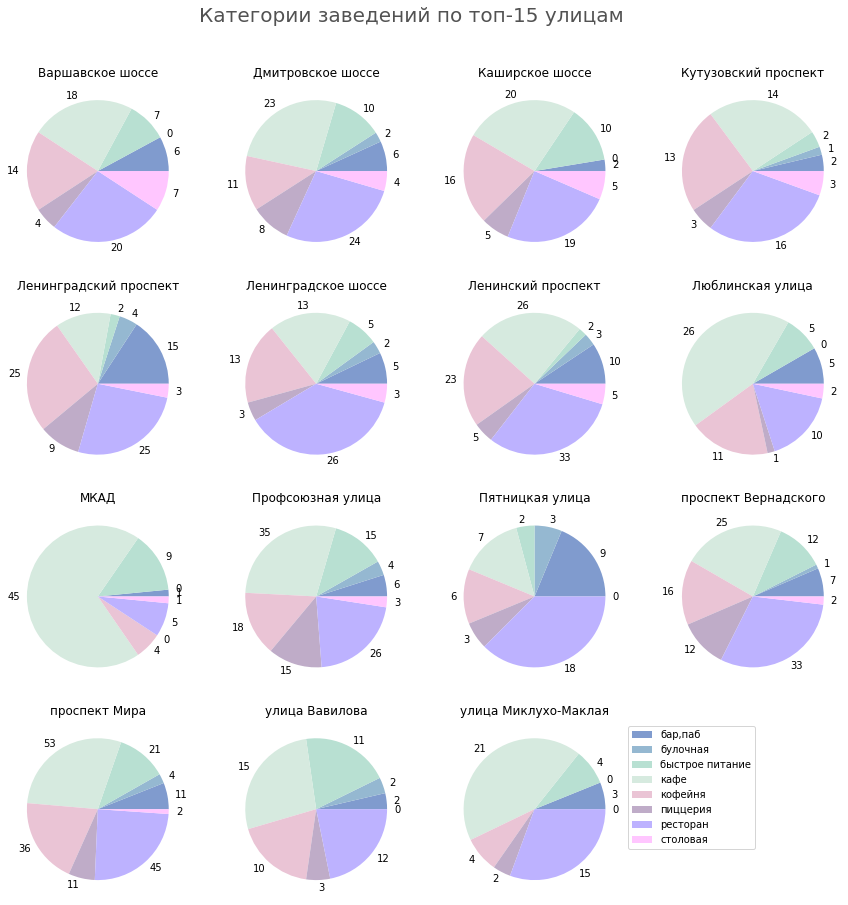

In [55]:
colors = ['#809bce', '#95b8d1', '#b8e0d2', '#d6eadf', '#eac4d5','#bfacc8', '#BDB2FF', '#FFC6FF']

def func(pct, allvals):
    absolute = int(np.round(pct/100.*np.sum(allvals)))
    return f"{pct:.1f}%\n({absolute:d})"

# fig, axes = plt.subplots(5,3, figsize=(15,15))
fig, axes = plt.subplots(4,4, figsize=(15,15))
fig.delaxes(ax= axes[3,3])  
title = fig.suptitle('Категории заведений по топ-15 улицам', y=.95, fontsize=20, color=font_color) 
# for ax, idx in zip(axes, table.index):
for i, (idx, row) in enumerate(table.iterrows()):
    #print(idx)
#     ax = axes[i // 3, i % 3]
    ax = axes[i // 4, i % 4]

    ax.pie(table.loc[idx], labels=table.loc[idx],colors=colors)
    ax.set(ylabel='', title=idx, aspect='equal')

# axes[0].legend(bbox_to_anchor=(0, 0.5))
ax.legend(table.columns.levels[1], bbox_to_anchor=(1, 1))
plt.show()

В пропорциях на МКАДе меньше всего ресторанов, но больше всего кафе.

In [57]:
# улицы, на которых находится только один объект общепита
data_groupped = data_groupped_street[data_groupped_street['count'] == 1]
data_groupped = data_groupped.merge(data, on=['street'], how='left')

data_groupped

,street,count,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,name_lower,is_24_7,middle_avg_bill_round,middle_coffee_cup_round
0,1-й Автозаводский проезд,1,Чайхана Азия,кафе,"Москва, 1-й Автозаводский проезд, 5",Южный административный округ,"ежедневно, круглосуточно",55.704847,37.657065,4.2,средние,Средний счёт:190–350 ₽,270.0,NaN,сетевое,20.0,чайхана азия,True,300.0,NaN
1,1-й Балтийский переулок,1,Хуан Хэ,ресторан,"Москва, 1-й Балтийский переулок, 3/25",Северный административный округ,"ежедневно, 12:00–22:00",55.810418,37.518824,4.4,высокие,Средний счёт:1500–2000 ₽,1750.0,NaN,не сетевое,60.0,хуан хэ,False,1800.0,NaN
2,1-й Варшавский проезд,1,Колизей,кафе,"Москва, 1-й Варшавский проезд, 1Ас9",Южный административный округ,пн-чт 10:00–00:00; пт-вс 10:00–05:00,55.648674,37.627979,4.0,NaN,NaN,NaN,NaN,не сетевое,NaN,колизей,False,NaN,NaN
3,1-й Вешняковский проезд,1,Deli by Shell,кафе,"Москва, 1-й Вешняковский проезд, 15",Юго-Восточный административный округ,неизвестно,55.723152,37.794014,3.4,NaN,NaN,NaN,NaN,не сетевое,NaN,deli by shell,False,NaN,NaN
4,1-й Голутвинский переулок,1,Shelby,"бар,паб","Москва, 1-й Голутвинский переулок, 6",Центральный административный округ,пн-пт 09:00–20:00,55.739600,37.613494,4.1,средние,Средний счёт:500–800 ₽,650.0,NaN,не сетевое,22.0,shelby,False,600.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
453,улица Шкулёва,1,Мираж,ресторан,"Москва, улица Шкулёва, 2А",Юго-Восточный административный округ,"пн-пт 11:00–23:00; сб,вс 11:00–00:00",55.693340,37.746231,4.7,NaN,NaN,NaN,NaN,не сетевое,90.0,мираж,False,NaN,NaN
454,улица Шкулёва 4,1,CofeFest,кофейня,"Москва, улица Шкулёва 4",Юго-Восточный административный округ,пн-пт 08:00–19:00,55.693299,37.749927,4.4,NaN,NaN,NaN,NaN,сетевое,NaN,cofefest,False,NaN,NaN
455,улица Шухова,1,Scirocco,ресторан,"Москва, улица Шухова, 21",Южный административный округ,"ежедневно, 12:00–00:00",55.716123,37.608472,4.1,высокие,Средний счёт:2500–3500 ₽,3000.0,NaN,не сетевое,90.0,scirocco,False,3000.0,NaN
456,улица Юннатов,1,Кафе-столовая,столовая,"Москва, улица Юннатов, 18",Северный административный округ,пн-пт 08:30–17:30,55.802610,37.558759,4.7,средние,Средний счёт:250–400 ₽,325.0,NaN,не сетевое,27.0,кафе-столовая,False,300.0,NaN


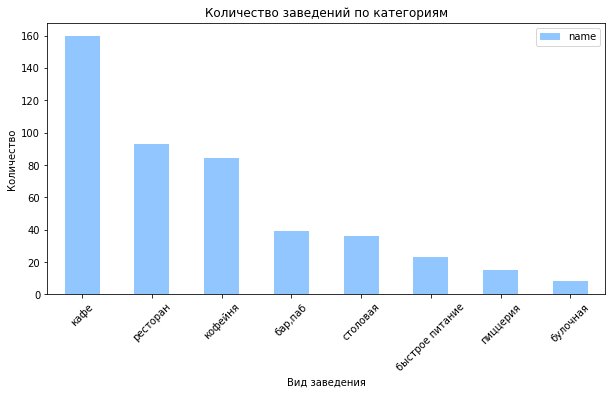

In [58]:
# количество единственных на улице заведений по категориям
data_pivot = data_groupped.pivot_table(index='category', values='name', aggfunc='count').sort_values(by=['name'], ascending=False)
data_pivot.plot(y='name', kind='bar', figsize=(10, 5));
plt.title('Количество заведений по категориям')
plt.xlabel('Вид заведения')
plt.ylabel('Количество')
plt.xticks(rotation=45)
plt.show()

Количество единственных на улице заведений по категориям распределяется похоже на распределение всего списка заведений, но столовых больше, чем пиццерий и быстрого питания. Возможно, потому, что столовые нужны и на непопулярных улицах, т.к. людям требуется где-то обедать.<br>

In [59]:
# фоновая картограмма (хороплет) со средним рейтингом заведений каждого района   
data_grouped = data.groupby(['district'])['middle_avg_bill'].agg('median')

m = folium.Map(location=[moscow_lat, moscow_lng], tiles='Cartodb Positron')

Choropleth(
    geo_data='/datasets/admin_level_geomap.geojson',
    data=data_grouped,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний чек заведений по районам',
).add_to(m)

m

Самые высокие средние чеки в центральном и ~~северо-~~западном районах, что объяснимо, эти районы считаются более престижными. 

In [60]:
data_grouped.sort_values(ascending=False)

district
Западный административный округ            1000.0
Центральный административный округ         1000.0
Северо-Западный административный округ      700.0
Северный административный округ             650.0
Юго-Западный административный округ         600.0
Восточный административный округ            575.0
Северо-Восточный административный округ     500.0
Южный административный округ                500.0
Юго-Восточный административный округ        450.0
Name: middle_avg_bill, dtype: float64

In [61]:
def get_hours_start(hours):
    if hours == 'неизвестно':
        return ''        
    try:
        if hours.find('ежедневно') != -1:
            if hours.find('ежедневно, круглосуточно') != -1:
                return 'круглосуточно'
            else:
                return hours[11:13]
        elif hours.find('пн') != -1 and hours.find(':') != -1:
            ind = hours.find(':')
            if hours[ind-2:ind].isdigit(): 
                return hours[ind-2:ind]   
        elif hours.find('пн,') != -1 and hours.find('круглосуточно') != -1:   
            return 'круглосуточно'
        else:
            print(hours)
            return 'не работает'
    except:
        print('error: ', hours)        
        pass

In [62]:
def get_start_week(hours_start_week):
    if hours_start_week.isdigit():
        if int(hours_start_week) >= 4 and int(hours_start_week) <= 6:
            return '04:00-06:00'
        elif int(hours_start_week) > 6 and int(hours_start_week) <= 9:
            return '07:00-09:00'
        elif int(hours_start_week) > 9 and int(hours_start_week) <= 12:
            return '10:00-12:00'
        elif int(hours_start_week) > 12 and int(hours_start_week) <= 17:
            return '13:00-17:00'
        elif int(hours_start_week) > 17 and int(hours_start_week) <= 23 or int(hours_start_week) == 0:
            return 'после 18:00'
        else:
            #print(hours_start_week)
            return ''
    elif hours_start_week == 'круглосуточно' or hours_start_week == 'не работает':
        return hours_start_week   
    else:
        #print(hours_start_week)
        return ''  

In [63]:
# начало работы в понедельник
data['hours_start_week'] = data['hours'].apply(get_hours_start)
data.head()

вт-сб 09:00–18:00
вт-вс 09:00–19:00
вт-вс 10:00–22:00
чт 20:00–02:00; пт,сб 20:00–06:00
вт-сб 20:00–06:00
вт-вс 11:00–23:00
вт-вс 10:00–20:00
чт 18:00–00:00; пт,сб 15:00–06:00; вс 15:00–00:00
вт,чт 10:00–18:00
вт-вс 10:45–21:00
вт-вс круглосуточно
вт-пт 12:00–20:00; сб,вс 12:00–22:00
вт-вс 10:00–22:00
чт-вс 20:00–06:00
сб круглосуточно
вт-вс 12:00–00:00
пт-вс круглосуточно
вт-вс 10:00–20:00
вт-сб 09:00–21:00
вт-вс 10:00–21:00
вт-вс 09:00–21:00
вт-вс 12:00–21:00
вт-вс 12:00–21:00
вт-вс 12:00–21:00
пт,сб 18:00–06:00
пт,сб 18:00–06:00
вт-чт 12:00–00:00; пт,сб 12:00–05:00; вс 12:00–00:00
вт-вс 12:00–00:00
вт-вс 14:00–22:00
сб,вс 10:00–20:00
ср-пт 10:00–18:00; сб,вс 10:00–19:00
сб,вс 09:00–21:00
ср-вс 09:00–21:00
вт-чт 10:00–20:30; пт,сб 10:00–21:30; вс 10:00–20:30
вт-вс 12:00–23:00
пт-вс 10:00–22:00
ср,чт 12:00–23:00; пт,сб 12:00–01:00; вс 12:00–23:00
вт-вс 12:00–23:00, перерыв 17:00–18:00
вт-вс 17:00–23:00
вт-чт 15:00–00:00; пт,сб 17:00–05:00
вт-сб 12:00–21:00
вт-сб 17:00–00:00
ср-пт 15:0

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,name_lower,is_24_7,street,middle_avg_bill_round,middle_coffee_cup_round,hours_start_week
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,не сетевое,NaN,wowфли,False,улица Дыбенко,NaN,NaN,10
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,не сетевое,4.0,четыре комнаты,False,улица Дыбенко,1600.0,NaN,10
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,не сетевое,45.0,хазри,False,Клязьминская улица,1000.0,NaN,11
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,средние,Цена чашки капучино:155–185 ₽,NaN,170.0,не сетевое,NaN,dormouse coffee shop,False,улица Маршала Федоренко,NaN,170.0,09
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,сетевое,148.0,иль марко,False,Правобережная улица,500.0,NaN,10


In [64]:
data['hours_start_week'].unique()

array(['10', '11', '09', '15', '12', 'круглосуточно', 'не работает', '08',
       '13', '', '16', '14', '07', '06', '17', '18', '00', '20', '19',
       '22', '05', '04', '21'], dtype=object)

In [65]:
data['start_week'] = data['hours_start_week'].apply(get_start_week)
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,...,middle_coffee_cup,chain,seats,name_lower,is_24_7,street,middle_avg_bill_round,middle_coffee_cup_round,hours_start_week,start_week
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,...,NaN,не сетевое,NaN,wowфли,False,улица Дыбенко,NaN,NaN,10,10:00-12:00
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,...,NaN,не сетевое,4.0,четыре комнаты,False,улица Дыбенко,1600.0,NaN,10,10:00-12:00
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,...,NaN,не сетевое,45.0,хазри,False,Клязьминская улица,1000.0,NaN,11,10:00-12:00
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,средние,Цена чашки капучино:155–185 ₽,...,170.0,не сетевое,NaN,dormouse coffee shop,False,улица Маршала Федоренко,NaN,170.0,09,07:00-09:00
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,...,NaN,сетевое,148.0,иль марко,False,Правобережная улица,500.0,NaN,10,10:00-12:00


In [66]:
# данные для графика заведений каждой категории по часам работы в пн
df_grouped = data.groupby(['start_week', 'category']).size().reset_index()
table = pd.pivot_table(df_grouped, index=['category'], columns=['start_week'])
table = table.fillna(0).astype(int)
table

0                                                  \
start_week           04:00-06:00 07:00-09:00 10:00-12:00 13:00-17:00   
category                                                               
бар,паб           18           3          93         520          51   
булочная           7           0         194          28           0   
быстрое питание   33           3         145         269           1   
кафе             374          19         766         896          18   
кофейня           15           8        1086         235           2   
пиццерия           5           0         136         454           3   
ресторан          74          10         437        1350          13   
столовая           9           1         250          41           1   

                                                       
start_week      круглосуточно не работает после 18:00  
category                                               
бар,паб                    52          16          11  
булочная                   24           3           0  
быстрое питание           150           2           0  
кафе                      269          26           9  
кофейня                    59           7           1  
пиццерия                   31           4           0  
ресторан                  135          16           7  
столовая                   12           0           1

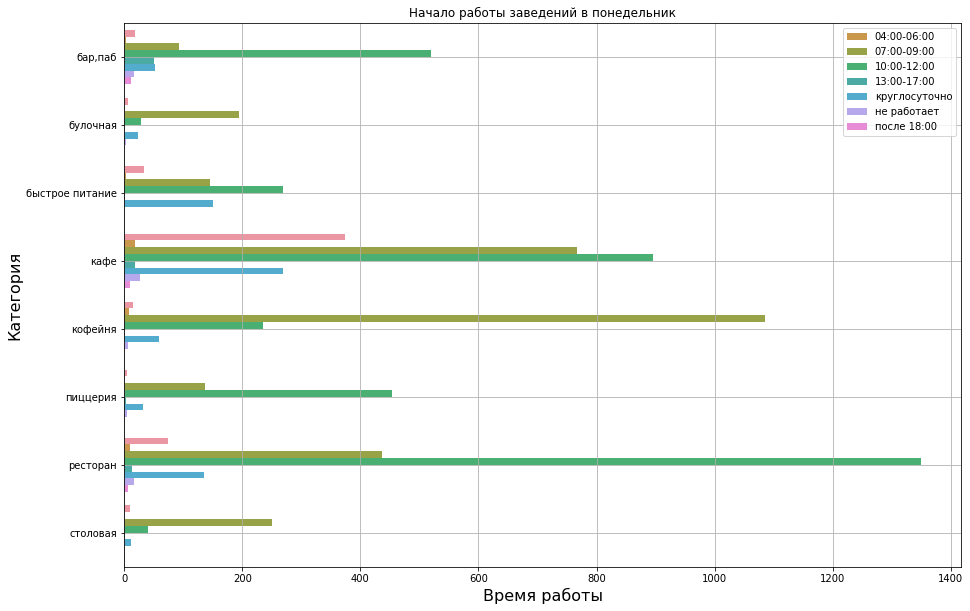

In [67]:
# график количества заведений по категорий в зависимости от начала работы в понедельник
data_groupped = (data.groupby(['category', 'start_week'], as_index = False)
                 .agg({'address':'count', 'rating':'median', 'middle_avg_bill':'median', 'middle_coffee_cup':'median',  'seats':'median'}))
# назначаем размер графика
plt.figure(figsize=(15, 10))
# строим столбчатый график средствами seaborn
with plt.style.context('seaborn-bright'):
    sns.barplot(x='address', y='category', data=data_groupped, hue='start_week')
plt.title('Начало работы заведений в понедельник')
plt.xlabel('Время работы', fontsize=16)
plt.ylabel('Категория', fontsize=16)
plt.legend(loc='upper right')
plt.grid()
plt.show() 

В основном заведения начинают свою работу в промежутке от 7 до 12 утра. <br>
Бары, быстрое питание, пиццерии и рестораны в большинстве начинают работать с 10 до 12. Булочные, кофейни и столовые начинают работать в основном с 7 до 9 утра. <br>

In [68]:
data_groupped = (data.groupby(['start_week'], as_index = False)
                 .agg({'address':'count', 'rating':'median', 'middle_avg_bill':'median', 'middle_coffee_cup':'median',  'seats':'median'}))
data_groupped

,start_week,address,rating,middle_avg_bill,middle_coffee_cup,seats
0,,535,4.20,1100.0,285.0,75.0
1,04:00-06:00,44,4.25,450.0,270.0,97.0
2,07:00-09:00,3107,4.30,400.0,165.0,70.0
3,10:00-12:00,3793,4.30,1000.0,189.0,80.0
4,13:00-17:00,89,4.40,1250.0,250.0,56.0
5,круглосуточно,732,4.20,425.0,256.0,60.0
6,не работает,74,4.30,400.0,184.0,45.0
7,после 18:00,29,4.40,1562.5,150.0,90.0


Чем позднее открывается заведение, тем больше средний чек - для заведений, которые начинают работать с 10:00 и с 13:00 - медианные чеки 1000.0 и 1250.0 соответственно, а медианный чек в заведениях, которые открываются после 18:00 - 1562 р.


In [69]:
# данные для графика заведений каждой категории по часам работы в пн
df_grouped = data.groupby(['start_week', 'district']).size().reset_index()
df_grouped['district'] = df_grouped['district'].str.replace('административный округ', '')
table = pd.pivot_table(df_grouped, index=['district'], columns=['start_week'])
table = table.fillna(0).astype(int)
table

0                                                  \
start_week            04:00-06:00 07:00-09:00 10:00-12:00 13:00-17:00   
district                                                                
Восточный          75           5         273         332           5   
Западный           65           3         293         396          11   
Северный           54           0         348         413           6   
Северо-Восточный   61           3         314         412          11   
Северо-Западный    40           1         152         161           5   
Центральный        31          11         922        1077          35   
Юго-Восточный      85          15         226         284           4   
Юго-Западный       59           2         243         321           5   
Южный              65           4         336         397           7   

                                                         
start_week        круглосуточно не работает после 18:00  
district                                                 
Восточный                    97           9           2  
Западный                     72           9           1  
Северный                     72           5           1  
Северо-Восточный             75          10           4  
Северо-Западный              43           6           1  
Центральный                 131          24          11  
Юго-Восточный                94           2           4  
Юго-Западный                 73           4           2  
Южный                        75           5           3

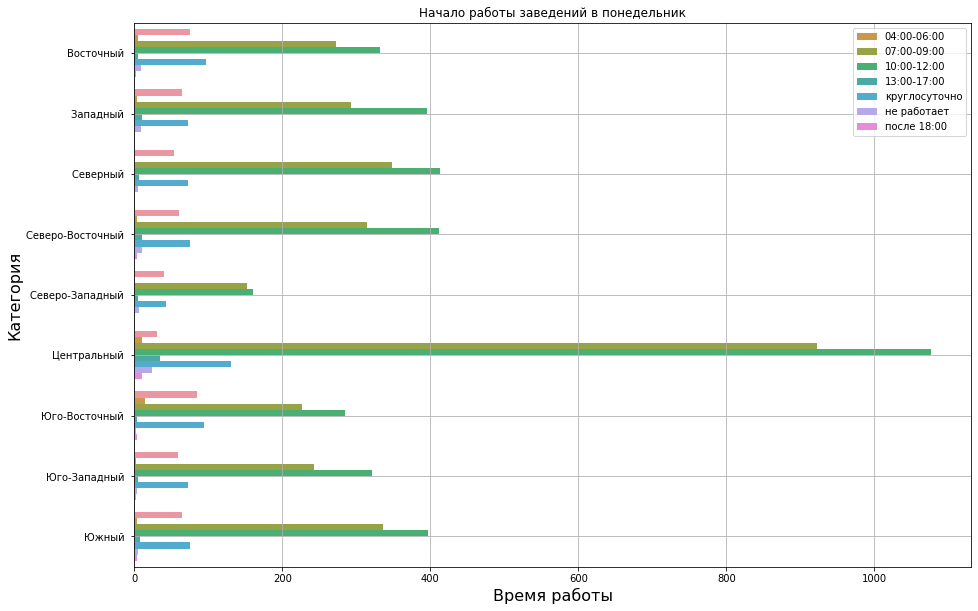

In [70]:
# график количества заведений по районам в зависимости от начала работы в понедельник
data_groupped = (data.groupby(['district', 'start_week'], as_index = False)
                 .agg({'address':'count', 'rating':'median', 'middle_avg_bill':'median', 'middle_coffee_cup':'median',  'seats':'median'}))
data_groupped['district'] = data_groupped['district'].str.replace('административный округ', '')
# назначаем размер графика
plt.figure(figsize=(15, 10))
# строим столбчатый график средствами seaborn
with plt.style.context('seaborn-bright'):
    sns.barplot(x='address', y='district', data=data_groupped, hue='start_week')
plt.title('Начало работы заведений в понедельник')
plt.xlabel('Время работы', fontsize=16)
plt.ylabel('Категория', fontsize=16)
plt.legend(loc='upper right')
plt.grid()
plt.show() 

In [71]:
data

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,...,middle_coffee_cup,chain,seats,name_lower,is_24_7,street,middle_avg_bill_round,middle_coffee_cup_round,hours_start_week,start_week
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,...,NaN,не сетевое,NaN,wowфли,False,улица Дыбенко,NaN,NaN,10,10:00-12:00
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,...,NaN,не сетевое,4.0,четыре комнаты,False,улица Дыбенко,1600.0,NaN,10,10:00-12:00
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,...,NaN,не сетевое,45.0,хазри,False,Клязьминская улица,1000.0,NaN,11,10:00-12:00
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,средние,Цена чашки капучино:155–185 ₽,...,170.0,не сетевое,NaN,dormouse coffee shop,False,улица Маршала Федоренко,NaN,170.0,09,07:00-09:00
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,...,NaN,сетевое,148.0,иль марко,False,Правобережная улица,500.0,NaN,10,10:00-12:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8401,Суши Мания,кафе,"Москва, Профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.552480,4.4,NaN,NaN,...,NaN,не сетевое,86.0,суши мания,False,Профсоюзная улица,NaN,NaN,09,07:00-09:00
8402,Миславнес,кафе,"Москва, Пролетарский проспект, 19, корп. 1",Южный административный округ,"ежедневно, 08:00–22:00",55.640875,37.656553,4.8,NaN,NaN,...,NaN,не сетевое,150.0,миславнес,False,Пролетарский проспект,NaN,NaN,08,07:00-09:00
8403,Самовар,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,средние,Средний счёт:от 150 ₽,...,NaN,не сетевое,150.0,самовар,True,Люблинская улица,200.0,NaN,круглосуточно,круглосуточно
8404,Чайхана Sabr,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,NaN,NaN,...,NaN,сетевое,150.0,чайхана sabr,True,Люблинская улица,NaN,NaN,круглосуточно,круглосуточно


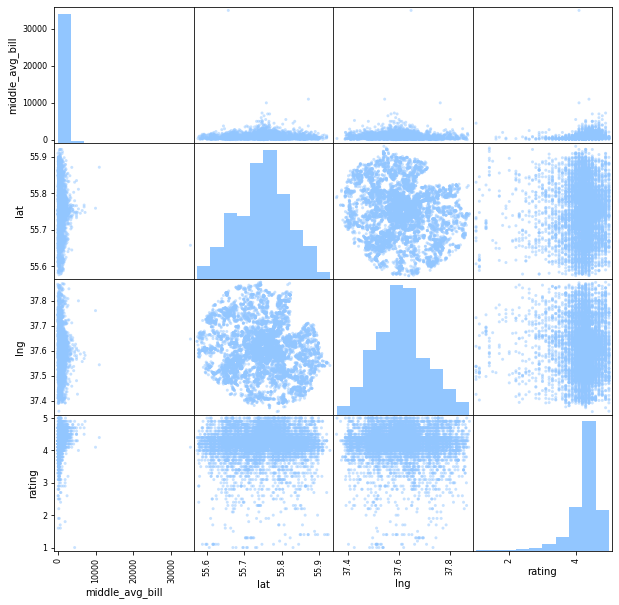

In [72]:
pd.plotting.scatter_matrix(data[['category', 'middle_avg_bill', 'lat', 'lng', 'rating']], figsize=(10, 10)) 
plt.show()

Корреляции между средним чеком, широтой, долготой и рейтингом не наблюдается. В ячейке lat-lng отображется что-то похожее на карту Москвы с заведениями.

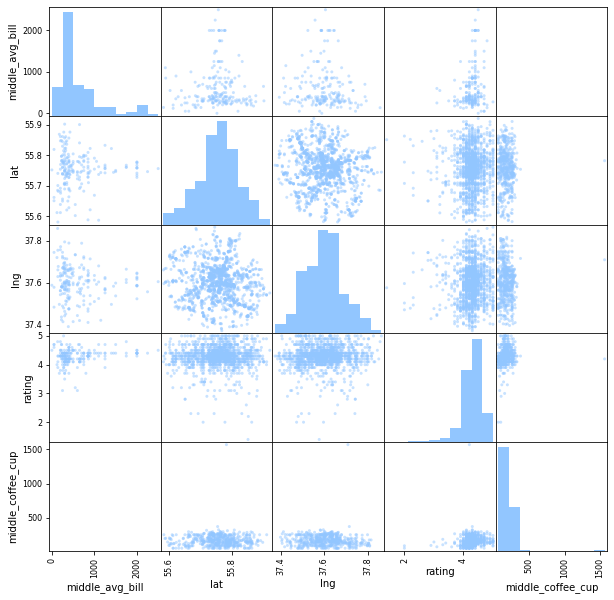

In [73]:
data_filter = data[data['category'] == 'кофейня'][['middle_avg_bill', 'lat', 'lng', 'rating', 'middle_coffee_cup']]
pd.plotting.scatter_matrix(data_filter, figsize=(10, 10)) 
plt.show()

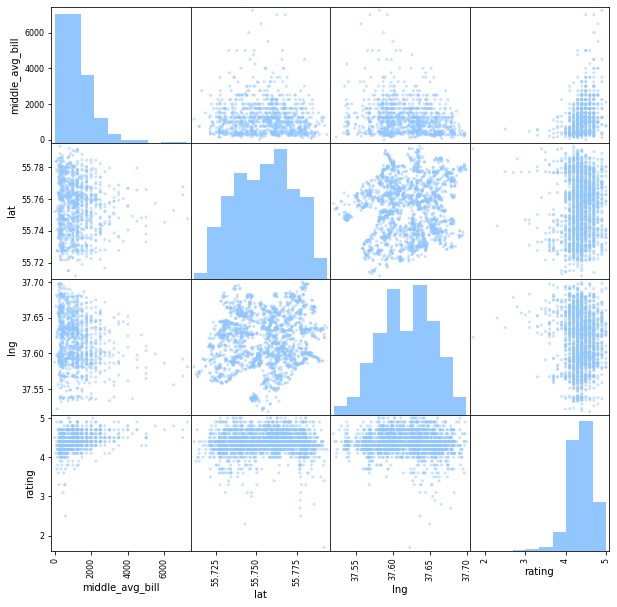

In [74]:
data_filter = data[data['district'] == 'Центральный административный округ'][['middle_avg_bill', 'lat', 'lng', 'rating']]
pd.plotting.scatter_matrix(data_filter, figsize=(10, 10)) 
plt.show()

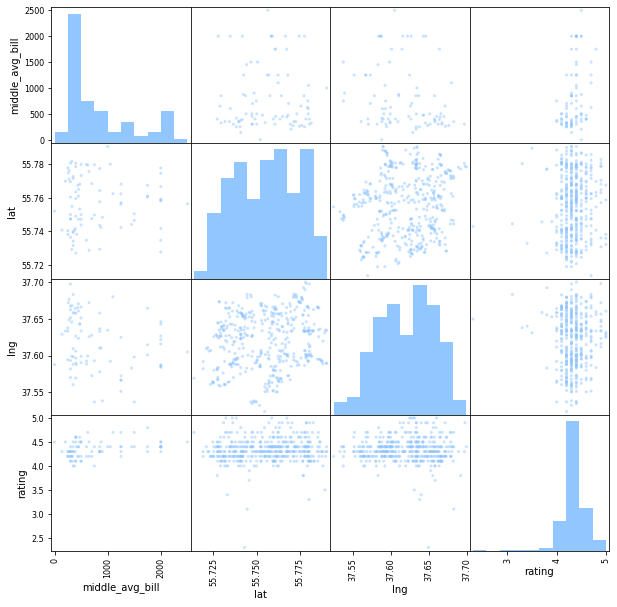

In [75]:
data_filter = data[(data['district'] == 'Центральный административный округ') & (data['category'] == 'кофейня')][['middle_avg_bill', 'lat', 'lng', 'rating']]
pd.plotting.scatter_matrix(data_filter, figsize=(10, 10)) 
plt.show()

Корреляции между средним чеком, широтой, долготой и рейтингом для кофеен, для заведений центрального района, для кофеен центрального района не наблюдается. 

Выводы:<br>
 
Среди заведений больше всего кафе, ресторанов и кофеен.

Больше всего посадочных мест в ресторанах (более 80), а также в барах, кофейнях, столовых и быстром питании. 60 и менее мест у кафе, пиццерий и булочных.
    
Не сетевых заведений - 62%, сетевых - 38%.

В разбивке по категориям заведения в основном не сетевые. Для разных категорий заведений пропорция сетевых и не сетевых отличается:<br>
    - у кофеен и пиццерий пропорции сетевых и не сетевых примерно равны<br>
    - у булочных больше сетевых заведений, чем не сетевых.<br>


В центральном районе заведений значительно больше, чем в других.<br>
Самые высокие средние чеки в центральном и северо-западном районах.<br>

Между средними рейтингами нет большой разницы по категориям заведений. Самые высокие рейтинги у баров - около 4.4. Ниже всего у кафе  и быстрого питания - 4.1 и 4.0. У остальных категорий - от 4.2 до 4.3.<br>  


#### Шаг 4. Детализируем исследование: открытие кофейни

In [76]:
# количество данных о кофейнях
data_coffee = data[data['category'] == 'кофейня'].copy().reset_index()
data_coffee.shape[0]

1413

In [77]:
data_coffee

,index,name,category,address,district,hours,lat,lng,rating,price,...,middle_coffee_cup,chain,seats,name_lower,is_24_7,street,middle_avg_bill_round,middle_coffee_cup_round,hours_start_week,start_week
0,3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,средние,...,170.0,не сетевое,NaN,dormouse coffee shop,False,улица Маршала Федоренко,NaN,170.0,09,07:00-09:00
1,25,В парке вкуснее,кофейня,"Москва, парк Левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,...,NaN,сетевое,NaN,в парке вкуснее,False,парк Левобережный,NaN,NaN,10,10:00-12:00
2,45,9 Bar Coffee,кофейня,"Москва, Коровинское шоссе, 41, стр. 1",Северный административный округ,пн-пт 08:00–18:00,55.885837,37.513422,4.0,NaN,...,NaN,сетевое,46.0,9 bar coffee,False,Коровинское шоссе,NaN,NaN,08,07:00-09:00
3,46,CofeFest,кофейня,"Москва, улица Маршала Федоренко, 6с1",Северный административный округ,пн-пт 09:00–19:00,55.879934,37.492522,3.6,NaN,...,NaN,сетевое,NaN,cofefest,False,улица Маршала Федоренко,NaN,NaN,09,07:00-09:00
4,52,Cofix,кофейня,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 08:00–22:00",55.878531,37.479395,3.8,NaN,...,NaN,сетевое,NaN,cofix,False,улица Дыбенко,NaN,NaN,08,07:00-09:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1408,8356,Назис Пури,кофейня,"Москва, Люблинская улица, 61",Юго-Восточный административный округ,"ежедневно, 09:00–22:00",55.684103,37.738588,4.5,NaN,...,NaN,не сетевое,NaN,назис пури,False,Люблинская улица,NaN,NaN,09,07:00-09:00
1409,8365,Квадрат кофе,кофейня,"Москва, Волгоградский проспект, 73, стр. 1",Юго-Восточный административный округ,"пн-пт 08:30–21:30; сб,вс 09:00–21:30",55.709710,37.744450,4.2,средние,...,160.0,не сетевое,206.0,квадрат кофе,False,Волгоградский проспект,NaN,160.0,08,07:00-09:00
1410,8376,Шоколад имбирь корица,кофейня,"Москва, Грайвороновская улица, 23",Юго-Восточный административный округ,пн-пт 09:30–19:30,55.721213,37.740755,4.1,NaN,...,NaN,не сетевое,NaN,шоколад имбирь корица,False,Грайвороновская улица,NaN,NaN,09,07:00-09:00
1411,8385,Cafio,кофейня,"Москва, Новохохловская улица, 49",Юго-Восточный административный округ,"пн-пт 07:00–22:00; сб,вс 07:00–21:00",55.724357,37.716415,4.7,низкие,...,100.0,не сетевое,NaN,cafio,False,Новохохловская улица,NaN,100.0,07,07:00-09:00


In [78]:
# количество кофеен из сетей
data_coffee[data_coffee['chain'] == 'сетевое'].shape[0]

720

In [79]:
# количество сетей кофеен
data_coffee[data_coffee['chain'] == 'сетевое'].groupby(['name'], as_index = False)[['address']].count().shape[0]

159

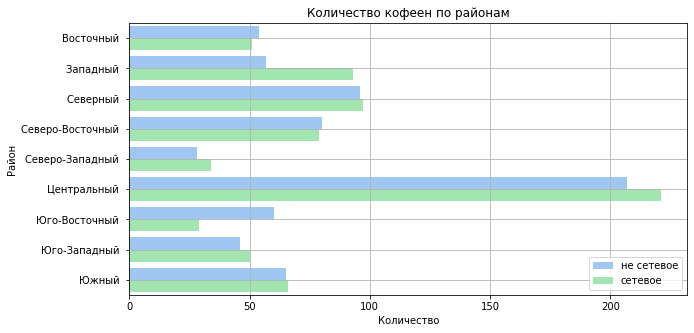

In [80]:
# категории заведений, которые чаще являются сетевыми
data_groupped = (data_coffee.groupby(['district', 'chain'], as_index = False)
                 .agg({'address':'count', 'rating':'median', 'middle_avg_bill':'median', 'middle_coffee_cup':'median',  'seats':'median'}))
data_groupped['district'] = data_groupped['district'].str.replace('административный округ', '')
# назначаем размер графика
plt.figure(figsize=(10, 5))
# строим столбчатый график средствами seaborn
sns.barplot(x='address', y='district', data=data_groupped, hue='chain')
plt.title('Количество кофеен по районам')
plt.xlabel('Количество')
plt.ylabel('Район')
plt.legend(loc='lower right', fontsize=10)
plt.grid()
plt.show() 

Больше всего кофеен в центральном районе.

In [81]:
data_groupped.sort_values(by=['rating'], ascending=False)

,district,chain,address,rating,middle_avg_bill,middle_coffee_cup,seats
8,Северо-Западный,не сетевое,28,4.45,300.0,165.0,25.5
0,Восточный,не сетевое,54,4.40,275.0,135.0,52.0
16,Южный,не сетевое,65,4.40,750.0,170.0,80.0
4,Северный,не сетевое,96,4.40,264.5,165.0,70.0
14,Юго-Западный,не сетевое,46,4.40,400.0,190.5,50.0
10,Центральный,не сетевое,207,4.40,462.5,195.0,50.0
12,Юго-Восточный,не сетевое,60,4.35,250.0,150.0,54.0
6,Северо-Восточный,не сетевое,80,4.35,300.0,162.5,52.0
2,Западный,не сетевое,57,4.30,600.0,170.0,98.0
15,Юго-Западный,сетевое,50,4.30,337.5,199.5,72.5


In [82]:
data_groupped = (data_coffee.groupby(['district'], as_index = False)
                 .agg({'address':'count', 'rating':'median', 'middle_avg_bill':'median', 'middle_coffee_cup':'median',  'seats':'median'}))

data_groupped.sort_values(by=['rating'], ascending=False)

,district,address,rating,middle_avg_bill,middle_coffee_cup,seats
0,Восточный административный округ,105,4.3,400.0,135.0,55.0
2,Северный административный округ,193,4.3,325.0,159.0,66.0
3,Северо-Восточный административный округ,159,4.3,325.0,162.5,75.0
4,Северо-Западный административный округ,62,4.3,325.0,165.0,87.5
5,Центральный административный округ,428,4.3,500.0,190.0,86.0
6,Юго-Восточный административный округ,89,4.3,250.0,147.5,50.0
7,Юго-Западный административный округ,96,4.3,375.0,198.0,64.5
8,Южный административный округ,131,4.3,387.5,150.0,80.0
1,Западный административный округ,150,4.2,600.0,189.0,96.0


In [83]:
# сеть 'One Price Coffee'
data_coffee[data_coffee['name'] == 'One Price Coffee'].sort_values(by=['rating'], ascending=False)

,index,name,category,address,district,hours,lat,lng,rating,price,...,middle_coffee_cup,chain,seats,name_lower,is_24_7,street,middle_avg_bill_round,middle_coffee_cup_round,hours_start_week,start_week
808,4445,One Price Coffee,кофейня,"Москва, Хоромный тупик, 2/6",Центральный административный округ,"ежедневно, 07:00–22:00",55.768192,37.648296,4.9,NaN,...,NaN,сетевое,NaN,one price coffee,False,Хоромный тупик,NaN,NaN,07,07:00-09:00
525,2755,One Price Coffee,кофейня,"Москва, Измайловское шоссе, 69Д",Восточный административный округ,"пн-пт 07:00–22:00; сб,вс 08:00–22:00",55.788299,37.747706,4.8,NaN,...,NaN,сетевое,55.0,one price coffee,False,Измайловское шоссе,NaN,NaN,07,07:00-09:00
64,456,One Price Coffee,кофейня,"Москва, Головинское шоссе, 5, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.840160,37.491902,4.6,NaN,...,NaN,сетевое,140.0,one price coffee,False,Головинское шоссе,NaN,NaN,10,10:00-12:00
1170,6386,One Price Coffee,кофейня,"Москва, улица Мастеркова, 4",Южный административный округ,"ежедневно, 07:00–21:30",55.708414,37.656100,4.4,NaN,...,NaN,сетевое,82.0,one price coffee,False,улица Мастеркова,NaN,NaN,07,07:00-09:00
433,2303,One Price Coffee,кофейня,"Москва, Верхняя Красносельская улица, 38/19с1",Центральный административный округ,"пн-пт 07:00–22:00; сб,вс 08:00–21:00",55.779545,37.665762,4.4,NaN,...,NaN,сетевое,NaN,one price coffee,False,Верхняя Красносельская улица,NaN,NaN,07,07:00-09:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
468,2448,One Price Coffee,кофейня,"Москва, проспект Мира, 112",Северо-Восточный административный округ,"пн-пт 08:00–21:00; сб,вс 07:00–23:00",55.806036,37.638039,3.3,NaN,...,NaN,сетевое,150.0,one price coffee,False,проспект Мира,NaN,NaN,08,07:00-09:00
1331,7760,One Price Coffee,кофейня,"Москва, улица Красного Маяка, 2",Южный административный округ,"ежедневно, 07:00–23:00",55.611691,37.601734,3.2,NaN,...,NaN,сетевое,0.0,one price coffee,False,улица Красного Маяка,NaN,NaN,07,07:00-09:00
476,2499,One Price Coffee,кофейня,"Москва, Сокольническая площадь, 4к1-2",Восточный административный округ,"ежедневно, 08:00–20:00",55.789975,37.677932,3.1,средние,...,80.0,сетевое,NaN,one price coffee,False,Сокольническая площадь,NaN,80.0,08,07:00-09:00
1300,7486,One Price Coffee,кофейня,"Москва, Люблинская улица, 112А",Юго-Восточный административный округ,"пн-пт 07:00–21:00; сб,вс 08:00–21:00",55.650631,37.743273,2.8,NaN,...,NaN,сетевое,NaN,one price coffee,False,Люблинская улица,NaN,NaN,07,07:00-09:00


В зависимости от района рейтинги кофеен почти не отличаются - значения 4.2 и 4.3. <br>
Медианное значение рейтинга немного выше у несетевых кофеен, чем у сетевых, но в рамках одной сети рейтинги кофеен могут сильно отличаться - например, у кофеен 'One Price Coffee' рейтинги  от 2.3 до 4.9.

In [84]:
# топ кофеен центрального района (оценка от 4.9)
data_coffee_top = (data_coffee[(data_coffee['district'] == 'Центральный административный округ')
                                & (data_coffee['rating'] >= 4.9)]
                 #.groupby(['name'], as_index = False)
                 #.agg({'address':'count', 'rating':'median', 'middle_avg_bill':'median', 'middle_coffee_cup':'median',  'seats':'median'}))
                 .sort_values(by=['rating'], ascending=False)
                 .head(20))
data_coffee_top

,index,name,category,address,district,hours,lat,lng,rating,price,...,middle_coffee_cup,chain,seats,name_lower,is_24_7,street,middle_avg_bill_round,middle_coffee_cup_round,hours_start_week,start_week
800,4408,Bodrero,кофейня,"Москва, улица Сретенка, 9",Центральный административный округ,"пн-пт 08:00–22:00; сб,вс 10:00–22:00",55.767602,37.631515,5.0,NaN,...,NaN,сетевое,28.0,bodrero,False,улица Сретенка,NaN,NaN,08,07:00-09:00
802,4411,За Думой,кофейня,"Москва, Лубянский проезд, 5, стр. 1",Центральный административный округ,"пн-пт 10:00–22:00; сб,вс 12:00–22:00",55.758780,37.629375,5.0,средние,...,NaN,не сетевое,80.0,за думой,False,Лубянский проезд,NaN,NaN,10,10:00-12:00
881,4818,La Vie Café,кофейня,"Москва, Воронцовская улица, 25, стр. 1",Центральный административный округ,пн-сб 08:00–21:00,55.735960,37.660395,5.0,средние,...,160.0,не сетевое,250.0,la vie café,False,Воронцовская улица,NaN,160.0,08,07:00-09:00
891,4900,The Coffee Club,кофейня,"Москва, улица Большая Ордынка, 31/12с1",Центральный административный округ,"пн-пт 08:00–21:00; сб,вс 09:00–21:00",55.738255,37.624661,5.0,средние,...,155.0,не сетевое,NaN,the coffee club,False,улица Большая Ордынка,NaN,160.0,08,07:00-09:00
893,4904,Yumbaker Home,кофейня,"Москва, Пятницкая улица, 66, стр. 1",Центральный административный округ,"ежедневно, 08:00–20:00",55.732256,37.626716,5.0,NaN,...,NaN,не сетевое,280.0,yumbaker home,False,Пятницкая улица,NaN,NaN,08,07:00-09:00
300,1757,Кофейня Борис Сонный,кофейня,"Москва, Селезнёвская улица, 32",Центральный административный округ,"ежедневно, 09:00–21:00",55.780726,37.611756,4.9,средние,...,190.0,не сетевое,NaN,кофейня борис сонный,False,Селезнёвская улица,NaN,190.0,09,07:00-09:00
403,2163,47,кофейня,"Москва, Центральный административный округ, Кр...",Центральный административный округ,"пн-пт 08:00–20:00; сб,вс 10:00–19:00",55.778830,37.645842,4.9,NaN,...,NaN,не сетевое,NaN,47,False,Центральный административный округ,NaN,NaN,08,07:00-09:00
416,2233,Ешь хлеб,кофейня,"Москва, Большая Почтовая улица, 26, стр. 1",Центральный административный округ,"ежедневно, 08:00–21:00",55.778835,37.697890,4.9,NaN,...,NaN,не сетевое,80.0,ешь хлеб,False,Большая Почтовая улица,NaN,NaN,08,07:00-09:00
435,2306,Он мой,кофейня,"Москва, проспект Мира, 45",Центральный административный округ,"пн-пт 07:30–19:30; сб,вс 10:30–19:30",55.782815,37.633718,4.9,NaN,...,NaN,не сетевое,6.0,он мой,False,проспект Мира,NaN,NaN,07,07:00-09:00
666,3673,Bodrero,кофейня,"Москва, улица Петровка, 19с1",Центральный административный округ,пн-чт 08:00–22:00; пт 08:00–23:00; сб 10:00–23...,55.764838,37.616355,4.9,NaN,...,NaN,сетевое,NaN,bodrero,False,улица Петровка,NaN,NaN,08,07:00-09:00


У кофеен в центральном районе с рейтингом от 4.9 только у 4 из 16 есть данные о цене кофе.

In [85]:
# топ кофеен центрального района (оценка от 4.7)
data_coffee_top = (data_coffee[(data_coffee['district'] == 'Центральный административный округ')
                                & (data_coffee['rating'] >= 4.7)]
                 #.groupby(['name'], as_index = False)
                 #.agg({'address':'count', 'rating':'median', 'middle_avg_bill':'median', 'middle_coffee_cup':'median',  'seats':'median'}))
                 .sort_values(by=['rating'], ascending=False)
                 .head(20))
data_coffee_top

,index,name,category,address,district,hours,lat,lng,rating,price,...,middle_coffee_cup,chain,seats,name_lower,is_24_7,street,middle_avg_bill_round,middle_coffee_cup_round,hours_start_week,start_week
802,4411,За Думой,кофейня,"Москва, Лубянский проезд, 5, стр. 1",Центральный административный округ,"пн-пт 10:00–22:00; сб,вс 12:00–22:00",55.758780,37.629375,5.0,средние,...,NaN,не сетевое,80.0,за думой,False,Лубянский проезд,NaN,NaN,10,10:00-12:00
893,4904,Yumbaker Home,кофейня,"Москва, Пятницкая улица, 66, стр. 1",Центральный административный округ,"ежедневно, 08:00–20:00",55.732256,37.626716,5.0,NaN,...,NaN,не сетевое,280.0,yumbaker home,False,Пятницкая улица,NaN,NaN,08,07:00-09:00
800,4408,Bodrero,кофейня,"Москва, улица Сретенка, 9",Центральный административный округ,"пн-пт 08:00–22:00; сб,вс 10:00–22:00",55.767602,37.631515,5.0,NaN,...,NaN,сетевое,28.0,bodrero,False,улица Сретенка,NaN,NaN,08,07:00-09:00
881,4818,La Vie Café,кофейня,"Москва, Воронцовская улица, 25, стр. 1",Центральный административный округ,пн-сб 08:00–21:00,55.735960,37.660395,5.0,средние,...,160.0,не сетевое,250.0,la vie café,False,Воронцовская улица,NaN,160.0,08,07:00-09:00
891,4900,The Coffee Club,кофейня,"Москва, улица Большая Ордынка, 31/12с1",Центральный административный округ,"пн-пт 08:00–21:00; сб,вс 09:00–21:00",55.738255,37.624661,5.0,средние,...,155.0,не сетевое,NaN,the coffee club,False,улица Большая Ордынка,NaN,160.0,08,07:00-09:00
866,4737,Церковный хлѣбъ,кофейня,"Москва, Никольская улица, 8/1с3",Центральный административный округ,"ежедневно, 10:00–22:00",55.757192,37.623324,4.9,NaN,...,NaN,не сетевое,NaN,церковный хлѣбъ,False,Никольская улица,NaN,NaN,10,10:00-12:00
808,4445,One Price Coffee,кофейня,"Москва, Хоромный тупик, 2/6",Центральный административный округ,"ежедневно, 07:00–22:00",55.768192,37.648296,4.9,NaN,...,NaN,сетевое,NaN,one price coffee,False,Хоромный тупик,NaN,NaN,07,07:00-09:00
803,4419,Столица,кофейня,"Москва, улица Земляной Вал, 2",Центральный административный округ,"ежедневно, круглосуточно",55.763066,37.656373,4.9,NaN,...,NaN,не сетевое,85.0,столица,True,улица Земляной Вал,NaN,NaN,круглосуточно,круглосуточно
300,1757,Кофейня Борис Сонный,кофейня,"Москва, Селезнёвская улица, 32",Центральный административный округ,"ежедневно, 09:00–21:00",55.780726,37.611756,4.9,средние,...,190.0,не сетевое,NaN,кофейня борис сонный,False,Селезнёвская улица,NaN,190.0,09,07:00-09:00
883,4841,Моремэй,кофейня,"Москва, Абельмановская улица, 7",Центральный административный округ,"ежедневно, 09:00–23:00",55.736198,37.671710,4.9,низкие,...,149.0,не сетевое,0.0,моремэй,False,Абельмановская улица,NaN,150.0,09,07:00-09:00


Топ кофеен центрального района:

In [86]:
# фоновая картограмма (хороплет) 
moscow_lat, moscow_lng = 55.751244, 37.618423
m = folium.Map(location=[moscow_lat, moscow_lng], zoom_start=12, tiles='Cartodb Positron')

data_grouped = data.groupby(['district'])['rating'].agg('median')

Choropleth(
    geo_data='/datasets/admin_level_geomap.geojson',
    data=data_grouped,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.2,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)

marker_cluster = MarkerCluster().add_to(m)

data_coffee_top.apply(create_clusters, axis=1)

m

In [87]:
# показатели топ-кофеен в центральном районе
(data_coffee_top.groupby(['category'], as_index = False)
 .agg({'rating':'median', 'middle_avg_bill':'median', 'middle_coffee_cup':'median',  'seats':'median'})
 )

,category,rating,middle_avg_bill,middle_coffee_cup,seats
0,кофейня,4.9,1750.0,190.0,62.5


При открытии кофейни в центре можно ориентироваться на среднюю цену за кофе 190 р, количество мест - 60.

In [88]:
# анти-топ кофеен центрального района 
data_coffee_best_worst = (data_coffee[(data_coffee['district'] == 'Центральный административный округ')
                                & ((data_coffee['rating'] < 4) )]
                 #.groupby(['name'], as_index = False)
                 #.agg({'address':'count', 'rating':'median', 'middle_avg_bill':'median', 'middle_coffee_cup':'median',  'seats':'median'}))
                 .sort_values(by=['rating'], ascending=True))
data_coffee_best_worst

,index,name,category,address,district,hours,lat,lng,rating,price,...,middle_coffee_cup,chain,seats,name_lower,is_24_7,street,middle_avg_bill_round,middle_coffee_cup_round,hours_start_week,start_week
977,5284,CofeFest,кофейня,"Москва, Гончарная улица, 23",Центральный административный округ,пн-пт 08:00–19:00,55.743056,37.649705,2.3,NaN,...,NaN,сетевое,NaN,cofefest,False,Гончарная улица,NaN,NaN,08,07:00-09:00
968,5242,Уголок,кофейня,"Москва, Рабочая улица, 13",Центральный административный округ,"пн-пт 07:30–21:00; сб,вс 09:00–21:00",55.744546,37.683024,3.1,NaN,...,NaN,сетевое,NaN,уголок,False,Рабочая улица,NaN,NaN,07,07:00-09:00
484,2526,Кофейня,кофейня,"Москва, Протопоповский переулок, 9, стр. 1",Центральный административный округ,пн-пт 09:00–19:00,55.780395,37.637846,3.3,NaN,...,NaN,не сетевое,86.0,кофейня,False,Протопоповский переулок,NaN,NaN,09,07:00-09:00
978,5300,Cofix,кофейня,"Москва, улица Зацепский Вал, 4, стр. 2",Центральный административный округ,"пн-пт 07:30–23:00; сб,вс 09:00–21:00",55.732997,37.639989,3.4,NaN,...,NaN,сетевое,NaN,cofix,False,улица Зацепский Вал,NaN,NaN,07,07:00-09:00
483,2524,Moscof Coffee,кофейня,"Москва, Трифоновская улица, 55",Центральный административный округ,"ежедневно, 09:00–19:00",55.789590,37.630771,3.5,NaN,...,NaN,не сетевое,NaN,moscof coffee,False,Трифоновская улица,NaN,NaN,09,07:00-09:00
888,4891,Ето,кофейня,"Москва, Большой Дровяной переулок, 18",Центральный административный округ,"пн-пт 08:30–23:00; сб,вс 09:00–23:00",55.745673,37.658530,3.7,NaN,...,NaN,не сетевое,NaN,ето,False,Большой Дровяной переулок,NaN,NaN,08,07:00-09:00
480,2516,Cofix,кофейня,"Москва, Комсомольская площадь, 3",Центральный административный округ,"ежедневно, круглосуточно",55.776955,37.655391,3.8,NaN,...,NaN,сетевое,200.0,cofix,True,Комсомольская площадь,NaN,NaN,круглосуточно,круглосуточно
481,2518,Мока,кофейня,"Москва, улица Фридриха Энгельса, 56, стр. 3",Центральный административный округ,пн-пт 08:00–19:00,55.777235,37.692106,3.8,NaN,...,NaN,не сетевое,98.0,мока,False,улица Фридриха Энгельса,NaN,NaN,08,07:00-09:00
1154,6301,Я кофе,кофейня,"Москва, Комсомольский проспект, 23/7",Центральный административный округ,"ежедневно, 07:00–23:00",55.727183,37.582998,3.8,NaN,...,NaN,не сетевое,NaN,я кофе,False,Комсомольский проспект,NaN,NaN,07,07:00-09:00
972,5265,Кофефест,кофейня,"Москва, Яузская улица, 11/6к5",Центральный административный округ,"пн-пт 08:00–19:00; сб,вс 09:00–17:00",55.745848,37.652562,3.9,NaN,...,NaN,не сетевое,NaN,кофефест,False,Яузская улица,NaN,NaN,08,07:00-09:00


In [89]:
# фоновая картограмма (хороплет) 
moscow_lat, moscow_lng = 55.751244, 37.618423
m = folium.Map(location=[moscow_lat, moscow_lng], zoom_start=12, tiles='Cartodb Positron')

data_filter = (data_coffee[(data_coffee['district'] == 'Центральный административный округ')
                                & ((data_coffee['rating'] < 4) | (data_coffee['rating'] >= 4.7))]
              )
data_grouped = data.groupby(['district'])['rating'].agg('median')

Choropleth(
    geo_data='/datasets/admin_level_geomap.geojson',
    data=data_grouped,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.2,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)

#marker_cluster = MarkerCluster().add_to(m)
data_filter.apply(create_marker_with_color, axis=1)


m

Карта с отмеченными цветом заведениями для поиска места для новой кофейни:

In [90]:
# фоновая картограмма (хороплет) 
moscow_lat, moscow_lng = 55.751244, 37.618423
m = folium.Map(location=[moscow_lat, moscow_lng], zoom_start=12, tiles='Cartodb Positron')

data_grouped = data.groupby(['district'])['rating'].agg('median')
data_filter = (data_coffee[(data_coffee['district'] == 'Центральный административный округ')])

Choropleth(
    geo_data='/datasets/admin_level_geomap.geojson',
    data=data_grouped,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.2,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)

marker_cluster = MarkerCluster().add_to(m)

data_filter.apply(create_marker_with_color, axis=1)
#data_filter.apply(create_clusters, axis=1)

m

При анализе данных на карте найдены места, где есть несколько кофеен, т.е. на них есть спрос, и при этом у этих кофеен не очень высокие рейтинги. Возможно, в таких местах стоит открыть новую кофейню:

In [91]:
# фоновая картограмма (хороплет) 
#moscow_lat, moscow_lng = 55.744277, 37.625900
moscow_lat, moscow_lng = 55.740242, 37.633521
m = folium.Map(location=[moscow_lat, moscow_lng], zoom_start=17, tiles='Cartodb Positron')

data_grouped = data.groupby(['district'])['rating'].agg('median')
data_filter = (data_coffee[(data_coffee['district'] == 'Центральный административный округ')])

Choropleth(
    geo_data='/datasets/admin_level_geomap.geojson',
    data=data_grouped,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.2,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)

data_filter.apply(create_marker_with_color, axis=1)  

m

In [92]:
# фоновая картограмма (хороплет) 
#moscow_lat, moscow_lng = 55.744277, 37.625900
moscow_lat, moscow_lng = 55.740909, 37.657526
m = folium.Map(location=[moscow_lat, moscow_lng], zoom_start=17, tiles='Cartodb Positron')

data_grouped = data.groupby(['district'])['rating'].agg('median')
data_filter = (data_coffee[(data_coffee['district'] == 'Центральный административный округ')])

Choropleth(
    geo_data='/datasets/admin_level_geomap.geojson',
    data=data_grouped,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.2,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)

data_filter.apply(create_marker_with_color, axis=1)  

m

In [93]:
# фоновая картограмма (хороплет) 
#moscow_lat, moscow_lng = 55.744277, 37.625900
moscow_lat, moscow_lng = 55.757398, 37.563574
m = folium.Map(location=[moscow_lat, moscow_lng], zoom_start=16, tiles='Cartodb Positron')

data_grouped = data.groupby(['district'])['rating'].agg('median')
data_filter = (data_coffee[(data_coffee['district'] == 'Центральный административный округ')])

Choropleth(
    geo_data='/datasets/admin_level_geomap.geojson',
    data=data_grouped,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.2,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)

data_filter.apply(create_marker_with_color, axis=1)  

m

In [94]:
# круглосуточные кофейни
data_coffee[data_coffee['is_24_7']]

,index,name,category,address,district,hours,lat,lng,rating,price,...,middle_coffee_cup,chain,seats,name_lower,is_24_7,street,middle_avg_bill_round,middle_coffee_cup_round,hours_start_week,start_week
26,200,Wild Bean,кофейня,"Москва, Дмитровское шоссе, 107Е",Северный административный округ,"ежедневно, круглосуточно",55.878477,37.543426,3.5,NaN,...,NaN,сетевое,20.0,wild bean,True,Дмитровское шоссе,NaN,NaN,круглосуточно,круглосуточно
153,971,Wild Bean Cafe,кофейня,"Москва, Ярославское шоссе, 116",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.867822,37.708853,4.0,NaN,...,NaN,сетевое,25.0,wild bean cafe,True,Ярославское шоссе,NaN,NaN,круглосуточно,круглосуточно
170,1047,Wild Bean Cafe,кофейня,"Москва, Ярославское шоссе, вл3с3",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.851778,37.676423,4.5,средние,...,170.0,сетевое,NaN,wild bean cafe,True,Ярославское шоссе,NaN,170.0,круглосуточно,круглосуточно
192,1214,Wild Bean Cafe,кофейня,"Москва, МКАД, 65-й километр, 8",Северо-Западный административный округ,"ежедневно, круглосуточно",55.813787,37.390701,4.3,NaN,...,NaN,сетевое,NaN,wild bean cafe,True,МКАД,NaN,NaN,круглосуточно,круглосуточно
204,1291,Шоколадница,кофейня,"Москва, улица Народного Ополчения, 49, корп. 1",Северо-Западный административный округ,"ежедневно, круглосуточно",55.794815,37.494834,4.2,средние,...,NaN,сетевое,200.0,шоколадница,True,улица Народного Ополчения,800.0,NaN,круглосуточно,круглосуточно
240,1468,Кофе Хауз,кофейня,"Москва, Ленинградский проспект, 74",Северный административный округ,"ежедневно, круглосуточно",55.805239,37.516246,4.0,средние,...,285.0,сетевое,NaN,кофе хауз,True,Ленинградский проспект,NaN,280.0,круглосуточно,круглосуточно
311,1790,Кофемания,кофейня,"Москва, Ленинградский проспект, 37А, корп. 14,...",Северный административный округ,"ежедневно, круглосуточно",55.790899,37.542776,4.7,NaN,...,NaN,сетевое,15.0,кофемания,True,Ленинградский проспект,NaN,NaN,круглосуточно,круглосуточно
319,1825,You&coffee,кофейня,"Москва, улица Золоторожский Вал, 11, стр. 21",Северный административный округ,"ежедневно, круглосуточно",55.803924,37.582251,4.2,NaN,...,NaN,сетевое,NaN,you&coffee,True,улица Золоторожский Вал,NaN,NaN,круглосуточно,круглосуточно
335,1883,Кофемания,кофейня,"Москва, Лесная улица, 5",Центральный административный округ,"ежедневно, круглосуточно",55.777804,37.586346,4.4,высокие,...,NaN,сетевое,140.0,кофемания,True,Лесная улица,2000.0,NaN,круглосуточно,круглосуточно
377,2030,Cinnabon,кофейня,"Москва, Долгоруковская улица, 40",Центральный административный округ,"ежедневно, круглосуточно",55.778271,37.601991,4.2,NaN,...,NaN,сетевое,230.0,cinnabon,True,Долгоруковская улица,NaN,NaN,круглосуточно,круглосуточно


In [95]:
data_coffee[data_coffee['is_24_7']].shape[0]

59

In [96]:
(data_coffee[data_coffee['is_24_7']]
 .groupby(['name', 'chain'], as_index = False)
 .agg({'address':'count', 'rating':'median', 'middle_avg_bill':'median', 'middle_coffee_cup':'median',  'seats':'median'})
 .sort_values(by=['address'], ascending=False))

,name,chain,address,rating,middle_avg_bill,middle_coffee_cup,seats
21,Шоколадница,сетевое,17,4.20,750.0,256.0,96.0
16,Кофемания,сетевое,8,4.40,2000.0,NaN,110.0
9,Wild Bean Cafe,сетевое,6,4.15,NaN,170.0,12.5
8,Wild Bean,сетевое,5,4.20,NaN,170.0,10.0
13,Кофе Хауз,сетевое,3,4.00,NaN,280.0,100.0
10,You&coffee,сетевое,2,4.45,NaN,NaN,20.0
1,Cofix,сетевое,2,4.05,NaN,NaN,200.0
14,Кофе с собой,сетевое,2,4.50,NaN,110.0,24.0
20,Столица,не сетевое,1,4.90,NaN,NaN,85.0
19,Пирог Хауз,сетевое,1,3.80,NaN,NaN,12.0


In [97]:
# частые расписания кофеен 
(data_coffee.groupby(['hours'], as_index = False)
 .agg({'name':'count', 'rating':'median', 'middle_avg_bill':'median', 'middle_coffee_cup':'median',  'seats':'median'})
 .sort_values(by=['name'], ascending=False)
 .head(10))

,hours,name,rating,middle_avg_bill,middle_coffee_cup,seats
48,"ежедневно, 10:00–22:00",140,4.2,400.0,184.0,100.0
25,"ежедневно, 08:00–22:00",60,4.3,487.5,195.0,99.0
62,"ежедневно, круглосуточно",59,4.2,1750.0,256.0,78.0
41,"ежедневно, 09:00–22:00",57,4.3,650.0,157.5,145.0
195,"пн-пт 08:00–21:00; сб,вс 09:00–21:00",46,4.4,400.0,170.0,37.0
155,пн-пт 08:00–19:00,46,4.1,375.0,139.0,90.0
40,"ежедневно, 09:00–21:00",43,4.3,400.0,175.0,53.5
209,"пн-пт 08:00–22:00; сб,вс 09:00–22:00",42,4.4,1337.5,225.0,92.0
24,"ежедневно, 08:00–21:00",36,4.4,725.0,160.0,46.0
154,пн-пт 08:00–18:30,34,4.2,487.5,95.0,78.0


In [98]:
# частое время открытия кофеен
data_groupped = (data_coffee.groupby(['hours_start_week'], as_index = False)
 .agg({'name':'count', 'rating':'median', 'middle_avg_bill':'median', 'middle_coffee_cup':'median',  'seats':'median'})
 .sort_values(by=['name'], ascending=False)
 .head(10))
data_groupped

,hours_start_week,name,rating,middle_avg_bill,middle_coffee_cup,seats
4,08,641,4.3,400.0,172.0,80.0
5,09,242,4.3,400.0,170.0,80.0
6,10,213,4.2,400.0,186.5,98.0
3,07,203,4.3,312.5,135.0,60.0
11,круглосуточно,59,4.2,1750.0,256.0,78.0
7,11,17,4.4,400.0,220.0,96.0
0,,15,4.4,NaN,285.0,55.0
2,06,8,4.5,2000.0,270.0,100.0
12,не работает,7,4.0,300.0,184.0,42.0
8,12,5,4.2,850.0,195.0,58.0


Круглосуточных кофеен 59.

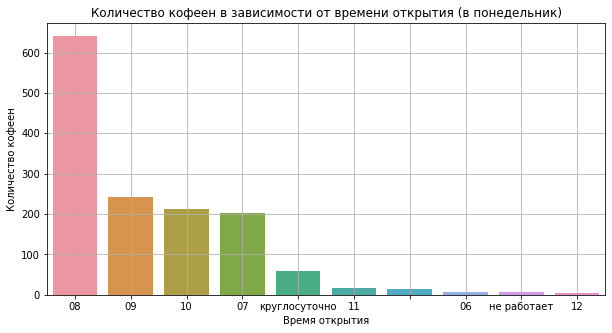

In [99]:
# график времени открытия кофеен
# назначаем размер графика
plt.figure(figsize=(10, 5))
# строим столбчатый график средствами seaborn
sns.barplot(x='hours_start_week', y='name', data=data_groupped)
plt.title('Количество кофеен в зависимости от времени открытия (в понедельник)')
plt.ylabel('Количество кофеен')
plt.xlabel('Время открытия')
# plt.legend(loc='lower right', fontsize=10)
plt.grid()
plt.show()

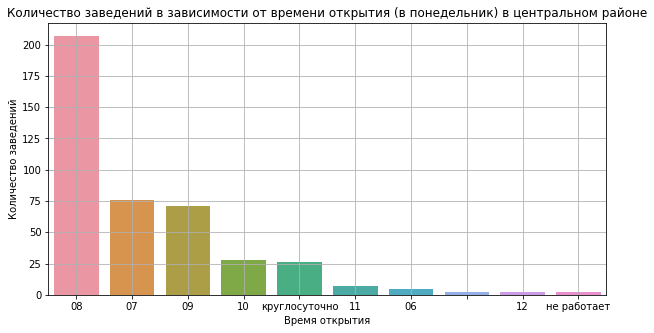

In [100]:
# частое время открытия кофеен в центральном районе
data_groupped = (data_coffee[data_coffee['district'] == 'Центральный административный округ']
                 .groupby(['hours_start_week'], as_index = False)
                 .agg({'name':'count', 'rating':'median', 'middle_avg_bill':'median', 'middle_coffee_cup':'median',  'seats':'median'})
                 .sort_values(by=['name'], ascending=False)
                 .head(10))

# график времени открытия кофеен в центральном районе
# назначаем размер графика
plt.figure(figsize=(10, 5))
# строим столбчатый график средствами seaborn
sns.barplot(x='hours_start_week', y='name', data=data_groupped)
plt.title('Количество заведений в зависимости от времени открытия (в понедельник) в центральном районе')
plt.ylabel('Количество заведений')
plt.xlabel('Время открытия')
# plt.legend(loc='lower right', fontsize=10)
plt.grid()
plt.show()

Самое частое время открытия кофейни - 8:00, для новой кофейни рекомендуется сделать время открытия не позднее.

#### Шаг 5. Подготовка презентации

Ссылка на презентацию:<br>
https://disk.yandex.ru/i/aRR6qLpgpthdFQ

#### Рекомендации

Для открытия новой кофейни рекомендуется:
- открыть кофейню в Центральном районе
- время открытия сделать 8:00 (или 7:00)
- при открытии кофейни в центре можно ориентироваться на среднюю цену за кофе 190 р, количество мест - 60